# Exploratory Data Analysis (EDA) – MVTec AD Dataset

This notebook performs an initial exploratory data analysis (EDA) of the MVTec Anomaly Detection (AD) dataset.
The goals are:
- Verify the dataset structure and availability of all categories.
- Understand the distribution of images across categories, splits, and defect types.
- Visualize example images for both normal and defective samples.
- Inspect ground truth masks for defect localization.

The insights gained here will help in designing the preprocessing pipeline and model evaluation strategy.


## 0. Base Transforms

Before performing any exploratory data analysis or training, it is essential to standardize the raw images into a consistent format.  
This step ensures that all images share the same size, channel order, and value range, making them compatible with batch processing and model input requirements.

**In this step, we:**
- Resize all images to a fixed resolution (256×256 pixels) to ensure uniform dimensions across the dataset.
- Convert images from `PIL` format to PyTorch tensors and scale pixel values from [0, 255] to [0, 1].
- Normalize each channel using standard ImageNet statistics (`mean` and `std`) to stabilize training and improve convergence.

These base transforms are applied consistently to both training and testing images, forming the foundation for any further data augmentation or model-specific preprocessing.


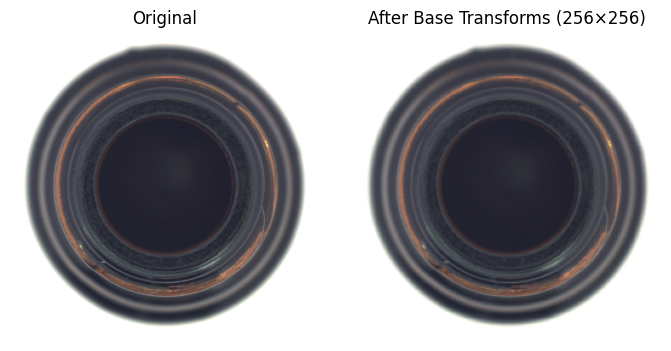

In [1]:
# ===== 0. Base Transforms (safe to add without breaking existing code) =====
from PIL import Image
import numpy as np
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import random

# Optional: only used if PyTorch/torchvision is installed
try:
    import torch
    from torchvision import transforms
except ImportError:
    torch = None
    transforms = None

# Unified target size
BASE_SIZE = (256, 256)

# Base transforms: Resize -> ToTensor -> Normalize (ImageNet stats)
if transforms is not None:
    base_transforms = transforms.Compose([
        transforms.Resize(BASE_SIZE),
        transforms.ToTensor(),  # [0,1], CxHxW
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
else:
    base_transforms = None  # Fallback if torchvision is not available

def apply_base_transforms_pil_to_tensor(img: Image.Image):
    """
    PIL -> Tensor (normalized). Returns None if torchvision/torch is not available.
    """
    if base_transforms is None:
        return None
    img = img.convert("RGB")
    return base_transforms(img)  # torch.FloatTensor [3,H,W]

def denormalize_tensor(t: "torch.Tensor"):
    """
    Denormalizes a tensor normalized with ImageNet stats back to [0,1].
    """
    mean = torch.tensor([0.485, 0.456, 0.406], device=t.device).view(3,1,1)
    std  = torch.tensor([0.229, 0.224, 0.225], device=t.device).view(3,1,1)
    return (t * std + mean).clamp(0, 1)

def tensor_to_numpy_for_viz(t: "torch.Tensor") -> np.ndarray:
    """
    Torch tensor [3,H,W] -> NumPy [H,W,3] (float in [0,1]) for plt.imshow.
    Automatically applies denormalization if base_transforms were used.
    """
    if t.ndim == 3 and t.shape[0] == 3:
        # We always attempt denormalization, assuming normalization was applied
        t = denormalize_tensor(t)
        arr = t.detach().cpu().permute(1, 2, 0).numpy()
        return arr
    raise ValueError("Expected a 3xHxW tensor.")

def load_image_with_base_transforms_np(path) -> np.ndarray:
    """
    Loads an image, applies base transforms, and returns a NumPy array [H,W,3] (float in [0,1]).
    Falls back to resize-only (no normalization) if torchvision is unavailable.
    Does NOT break your existing load_image() function.
    """
    img = Image.open(path).convert("RGB")
    if base_transforms is None:
        # Minimal: only resize for uniformity; output as float [0,1]
        img = img.resize(BASE_SIZE)
        arr = np.asarray(img).astype(np.float32) / 255.0
        return arr
    else:
        t = apply_base_transforms_pil_to_tensor(img)  # normalized tensor
        return tensor_to_numpy_for_viz(t)  # denormalized [0,1] for visualization

# --- Optional: Show before/after in a notebook ---
def show_before_after(img_path):
    """
    Shows original (left) and after base transforms (right) using Matplotlib.
    Uses load_image_with_base_transforms_np() for the right side to ensure correct display.
    """
    import matplotlib.pyplot as plt
    orig = Image.open(img_path).convert("RGB")
    after = load_image_with_base_transforms_np(img_path)  # [0,1] float

    fig, axes = plt.subplots(1, 2, figsize=(7, 3.5))
    axes[0].imshow(orig)
    axes[0].set_title("Original")
    axes[0].axis("off")

    axes[1].imshow(after)
    axes[1].set_title(f"After Base Transforms ({BASE_SIZE[1]}×{BASE_SIZE[0]})")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

# Path to dataset
DATA_ROOT = Path("../data/mvtec").resolve()
assert DATA_ROOT.exists(), f"Dataset not found at {DATA_ROOT}"
# Example (adjust path accordingly):
show_before_after(DATA_ROOT / "bottle" / "train" / "good" / "000.png")


## 1. Dataset Categories Check

We begin by scanning the dataset directory to list all top-level folders.  
The goal is to verify that all MVTec AD categories are present and identify any extra folders that are not part of the dataset.



In [2]:
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import random
from PIL import Image

# Path to dataset
DATA_ROOT = Path("../data/mvtec").resolve()
assert DATA_ROOT.exists(), f"Dataset not found at {DATA_ROOT}"

# List categories (folders in DATA_ROOT)
categories = sorted([p.name for p in DATA_ROOT.iterdir() if p.is_dir()])
print(f"{len(categories)} categories found:", categories)

16 categories found: ['.ipynb_checkpoints', 'bottle', 'cable', 'capsule', 'carpet', 'grid', 'hazelnut', 'leather', 'metal_nut', 'pill', 'screw', 'tile', 'toothbrush', 'transistor', 'wood', 'zipper']


**Next Step:**  
Remove any non-category folders from the dataset directory — in this case, `.ipynb_checkpoints`.  
This ensures that only the 15 valid MVTec AD categories are kept for further processing.  
The `.ipynb_checkpoints` folder is automatically created by Jupyter and does not contain any relevant data,  
so it can be safely ignored or deleted.


In [3]:
from pathlib import Path

# Expected MVTec AD categories (15)
MVTEC_CATEGORIES = {
    'bottle','cable','capsule','carpet','grid','hazelnut','leather',
    'metal_nut','pill','screw','tile','toothbrush','transistor','wood','zipper'
}

# Rebuild the categories list: only keep known categories under DATA_ROOT
categories = sorted([p.name for p in DATA_ROOT.iterdir()
                     if p.is_dir() and p.name in MVTEC_CATEGORIES])

print(f"{len(categories)} valid categories found:", categories)


15 valid categories found: ['bottle', 'cable', 'capsule', 'carpet', 'grid', 'hazelnut', 'leather', 'metal_nut', 'pill', 'screw', 'tile', 'toothbrush', 'transistor', 'wood', 'zipper']


## 2. Data Loading & Overview

After identifying the available categories, the next step is to count the number of images for each category, split (train/test), and label (e.g., *good*, *scratch*, etc.).  
This provides a clear picture of the dataset distribution and helps detect potential class imbalances or missing data early on.


In [4]:
import itertools
from pathlib import Path
import pandas as pd
pd.set_option("display.max_rows", None)    # No row limit
pd.set_option("display.max_colwidth", None) # Full column width


IMG_EXTS = {".png", ".jpg", ".jpeg"}

def count_images_for_category(cat_root: Path):
    rows = []
    for split in ("train", "test"):
        split_dir = cat_root / split
        if not split_dir.exists():
            continue
        # labels are subfolders in split_dir (e.g., 'good', 'scratch', ...)
        for label_dir in sorted([d for d in split_dir.iterdir() if d.is_dir() and d.name != ".ipynb_checkpoints"]):
            n = sum(1 for p in label_dir.rglob("*") if p.suffix.lower() in IMG_EXTS)
            rows.append({
                "category": cat_root.name,
                "split": split,
                "label": label_dir.name,
                "count": n
            })
    return rows

rows = list(itertools.chain.from_iterable(
    count_images_for_category(DATA_ROOT / c) for c in categories
))
df_counts = pd.DataFrame(rows).sort_values(["category","split","label"]).reset_index(drop=True)
df_counts


,category,split,label,count
0,bottle,test,broken_large,20
1,bottle,test,broken_small,22
2,bottle,test,contamination,21
3,bottle,test,good,20
4,bottle,train,good,209
5,cable,test,bent_wire,13
6,cable,test,cable_swap,12
7,cable,test,combined,11
8,cable,test,cut_inner_insulation,14
9,cable,test,cut_outer_insulation,10


### Initial Image Count Table

The table **above** shows the number of images per **category**, **split** (train/test), and **label**.  
Although it accurately represents the dataset structure, it is **not very reader-friendly**:

- It is long and requires scrolling to read fully.
- It mixes *good* and *defect* labels without any grouping.
- It does not provide category-level totals or defect proportions.

In the next step, we will create a **more aggregated and compact summary table**  
to make category comparisons and defect ratios easier to understand at a glance.


In [5]:
# ----- Richer summaries for MVTec counts (robust, no useless pivot) -----

# 1) Category-level summary (totals, good vs. defects, shares)
totals_by_cat = df_counts.groupby("category")["count"].sum().rename("total_images")

good_by_cat = (
    df_counts[df_counts["label"] == "good"]
    .groupby("category")["count"].sum()
    .rename("good_images")
)

defects_by_cat = (
    df_counts[df_counts["label"] != "good"]
    .groupby("category")["count"].sum()
    .rename("defect_images")
)

# Split-wise (train/test) good & defects
good_split = (
    df_counts[df_counts["label"] == "good"]
    .groupby(["category", "split"])["count"].sum()
    .unstack("split", fill_value=0)
)
good_split = good_split.reindex(columns=["train", "test"], fill_value=0).add_prefix("good_")

defects_split = (
    df_counts[df_counts["label"] != "good"]
    .groupby(["category", "split"])["count"].sum()
    .unstack("split", fill_value=0)
)
defects_split = defects_split.reindex(columns=["train", "test"], fill_value=0).add_prefix("defect_")

# Base summary
summary = (
    pd.concat([totals_by_cat, good_by_cat, defects_by_cat], axis=1)
    .fillna(0)
)

# Shares & ratios
summary["good_share"]   = (summary["good_images"] / summary["total_images"]).replace([float("inf"), float("nan")], 0).round(3)
summary["defect_share"] = (summary["defect_images"] / summary["total_images"]).replace([float("inf"), float("nan")], 0).round(3)

# Merge split-wise breakdowns
summary = (
    summary
    .join(good_split, how="left")
    .join(defects_split, how="left")
    .fillna(0)
)

# Make sure expected numeric columns exist before astype
expected_cols = ["total_images", "good_images", "defect_images",
                 "good_train", "good_test", "defect_train", "defect_test"]
for col in expected_cols:
    if col not in summary.columns:
        summary[col] = 0

# Enforce integer dtypes
summary = summary.astype({
    "total_images": int, "good_images": int, "defect_images": int,
    "good_train": int, "good_test": int, "defect_train": int, "defect_test": int
}).sort_values(["defect_test", "defect_train", "total_images"], ascending=False)

# Nice HTML display in Jupyter
from IPython.display import display
with pd.option_context(
    "display.max_columns", None,
    "display.width", 0,
    "display.expand_frame_repr", False
):
    display(summary)





,total_images,good_images,defect_images,good_share,defect_share,good_train,good_test,defect_train,defect_test
category,,,,,,,,,
pill,434,293,141,0.675,0.325,267,26,0,141
screw,480,361,119,0.752,0.248,320,41,0,119
zipper,391,272,119,0.696,0.304,240,32,0,119
capsule,351,242,109,0.689,0.311,219,23,0,109
metal_nut,335,242,93,0.722,0.278,220,22,0,93
cable,374,282,92,0.754,0.246,224,58,0,92
leather,369,277,92,0.751,0.249,245,32,0,92
carpet,397,308,89,0.776,0.224,280,28,0,89
tile,347,263,84,0.758,0.242,230,33,0,84


### Observations from the Summary Table Above

From the table **above**, we can observe the following:

- In every category, the **total number of good images** is higher than the number of defect images overall.  
  This is because the model is trained **only on good images**.
- In the **test split**, there are significantly more defect images than good ones.  
  This is intentional, as the focus of this work is on detecting and localizing these defects.
- Each label folder (subdirectory) across all categories contains **at least 12 images** and **at most 391 images**,  
  ensuring that even the smallest classes have enough samples for evaluation.



## 3. Ground Truth Masks Overview

After analyzing the distribution of input images, the next step is to inspect the **ground_truth** masks provided in the MVTec AD dataset.  
These masks are binary images that mark the exact defect regions at the pixel level:

- **White pixels (1)** → defect areas  
- **Black pixels (0)** → non-defective areas

### Goals of this step:
- Count the number of mask files for each **category** and **defect label**.
- Verify that for every defective image in the **test** set there is exactly **one matching mask file**.
- Identify any **mismatches** or **missing masks**.
- Summarize the **minimum** and **maximum** number of masks per defect type and category.

### Why this matters:
The ground truth masks are essential for **pixel-level evaluation metrics** such as:
- **Pixel-wise AUROC** – measuring how well the model detects defects on a pixel basis.
- **Mean Intersection over Union (mIoU)** – comparing predicted defect regions to the actual annotated areas.
- **Per-pixel Precision/Recall** – assessing segmentation quality.

By validating the masks early, we ensure that the dataset is **consistent** and **ready** for accurate evaluation of pixel-level defect detection.


In [6]:
# ===== Chapter 3: Ground Truth Masks Check =====

from pathlib import Path
from IPython.display import display

MASK_EXTS = {".png"}  # MVTec masks are .png

def is_checkpoint_dir(p: Path) -> bool:
    return p.name == ".ipynb_checkpoints"

def image_stem(p: Path) -> str:
    """Return base stem for comparison. For masks, strip trailing '_mask'."""
    s = p.stem  # e.g., '000' or '000_mask'
    return s[:-5] if s.endswith("_mask") else s

def iter_defect_images(cat_root: Path):
    """
    Yield (label, path) for defect images in test split (exclude 'good' and checkpoints).
    Example image path: <cat>/test/crack/000.png
    """
    test_dir = cat_root / "test"
    if not test_dir.exists():
        return
    for label_dir in sorted([d for d in test_dir.iterdir() if d.is_dir() and not is_checkpoint_dir(d) and d.name != "good"]):
        for p in label_dir.rglob("*"):
            if p.is_file() and p.suffix.lower() in IMG_EXTS:
                yield (label_dir.name, p)

def iter_masks(cat_root: Path):
    """
    Yield (label, path) for mask files under ground_truth.
    Example mask path: <cat>/ground_truth/crack/000_mask.png
    """
    gt_dir = cat_root / "ground_truth"
    if not gt_dir.exists():
        return
    for label_dir in sorted([d for d in gt_dir.iterdir() if d.is_dir() and not is_checkpoint_dir(d)]):
        for p in label_dir.rglob("*"):
            if p.is_file() and p.suffix.lower() in MASK_EXTS:
                yield (label_dir.name, p)

def build_gt_summary_for_category(cat_root: Path):
    """
    For a single category:
    - Count defect test images per label
    - Count masks per label
    - Check 1:1 filename matching
    Returns:
        counts_rows: list of dict rows with numeric counts
        issues_rows: list of dict rows with sample mismatches
    """
    # Collect stems per label
    img_map = {}   # label -> set(stems)
    mask_map = {}  # label -> set(stems)  (mask stems normalized: '000_mask' -> '000')

    for lbl, p in iter_defect_images(cat_root):
        img_map.setdefault(lbl, set()).add(image_stem(p))

    for lbl, p in iter_masks(cat_root):
        mask_map.setdefault(lbl, set()).add(image_stem(p))

    labels = sorted(set(img_map.keys()) | set(mask_map.keys()))

    counts_rows = []
    issues_rows = []

    for lbl in labels:
        img_stems = img_map.get(lbl, set())
        msk_stems = mask_map.get(lbl, set())

        missing_masks = sorted(img_stems - msk_stems)          # images without a matching mask
        extra_masks   = sorted(msk_stems - img_stems)          # masks without a matching image

        counts_rows.append({
            "category": cat_root.name,
            "label": lbl,
            "defect_images_test": len(img_stems),
            "masks": len(msk_stems),
            "match_ok": len(img_stems) == len(msk_stems) and not missing_masks and not extra_masks
        })

        # Store up to a few examples for readability
        if missing_masks:
            issues_rows.append({
                "category": cat_root.name,
                "label": lbl,
                "issue": "missing_masks_for_images",
                "examples": ", ".join(missing_masks[:5]) + (" ..." if len(missing_masks) > 5 else "")
            })
        if extra_masks:
            issues_rows.append({
                "category": cat_root.name,
                "label": lbl,
                "issue": "extra_masks_without_images",
                "examples": ", ".join(extra_masks[:5]) + (" ..." if len(extra_masks) > 5 else "")
            })

    return counts_rows, issues_rows

# ----- Run for all categories -----
all_counts = []
all_issues = []

for c in categories:
    cat_root = DATA_ROOT / c
    if not cat_root.exists() or is_checkpoint_dir(cat_root):
        continue
    c_rows, i_rows = build_gt_summary_for_category(cat_root)
    all_counts.extend(c_rows)
    all_issues.extend(i_rows)

df_gt_counts = pd.DataFrame(all_counts).sort_values(["category", "label"]).reset_index(drop=True)
df_gt_issues = pd.DataFrame(
    all_issues,
    columns=["category", "label", "issue", "examples"]
).sort_values(["category", "label", "issue"]).reset_index(drop=True)

# ----- Merge with expected defect counts from df_counts (test, label != 'good') -----
df_expected = (
    df_counts[(df_counts["split"] == "test") & (df_counts["label"] != "good")]
    .rename(columns={"count": "defect_images_test_expected"})
    [["category", "label", "defect_images_test_expected"]]
)

df_gt_check = (
    df_gt_counts
    .merge(df_expected, on=["category", "label"], how="outer")
    .fillna({"defect_images_test": 0, "masks": 0, "defect_images_test_expected": 0, "match_ok": False})
)

# Add comparison flags
df_gt_check["counts_match_expected"] = (df_gt_check["defect_images_test"] == df_gt_check["defect_images_test_expected"])
df_gt_check["masks_match_images"]   = (df_gt_check["masks"] == df_gt_check["defect_images_test"])

# Pretty display
with pd.option_context("display.max_rows", None, "display.max_columns", None, "display.expand_frame_repr", False, "display.width", 0):
    print("Ground Truth – Per Category/Label Counts and Checks:")
    display(df_gt_check)

    if not df_gt_issues.empty:
        print("\nGround Truth – Mismatches (examples):")
        display(df_gt_issues)
    else:
        print("\nGround Truth – No mismatches found. All defect images have exactly one mask and vice versa.")


Ground Truth – Per Category/Label Counts and Checks:


,category,label,defect_images_test,masks,match_ok,defect_images_test_expected,counts_match_expected,masks_match_images
0,bottle,broken_large,20,20,True,20,True,True
1,bottle,broken_small,22,22,True,22,True,True
2,bottle,contamination,21,21,True,21,True,True
3,cable,bent_wire,13,13,True,13,True,True
4,cable,cable_swap,12,12,True,12,True,True
5,cable,combined,11,11,True,11,True,True
6,cable,cut_inner_insulation,14,14,True,14,True,True
7,cable,cut_outer_insulation,10,10,True,10,True,True
8,cable,missing_cable,12,12,True,12,True,True
9,cable,missing_wire,10,10,True,10,True,True



Ground Truth – No mismatches found. All defect images have exactly one mask and vice versa.


✅ **Ground Truth Check – Passed**

All defective test images have exactly **one corresponding mask** in the *ground_truth* directory, and no extra masks were found without a matching image.  
This confirms that the dataset is **fully consistent** for pixel-level evaluation, ensuring reliable computation of metrics such as **Pixel-wise AUROC**, **mIoU**, and **per-pixel Precision/Recall** in the subsequent steps.


## 4. Sample Visualization & Sanity Check

Before proceeding with feature extraction or model training, a **visual inspection** of the data is performed.  
The goal is to ensure that the **ground truth masks** are correctly aligned with their corresponding test images.

### Objectives:
- **Randomly sample** defect images along with their masks.
- Overlay masks in color on top of the original images.
- Verify that defect regions are correctly and fully annotated.
- Visually compare different defect types.

### Why this matters:
- Ensures there are no incorrect or misaligned annotations.
- Provides a better understanding of the visual nature of defects.
- Helps guide preprocessing and model design decisions.



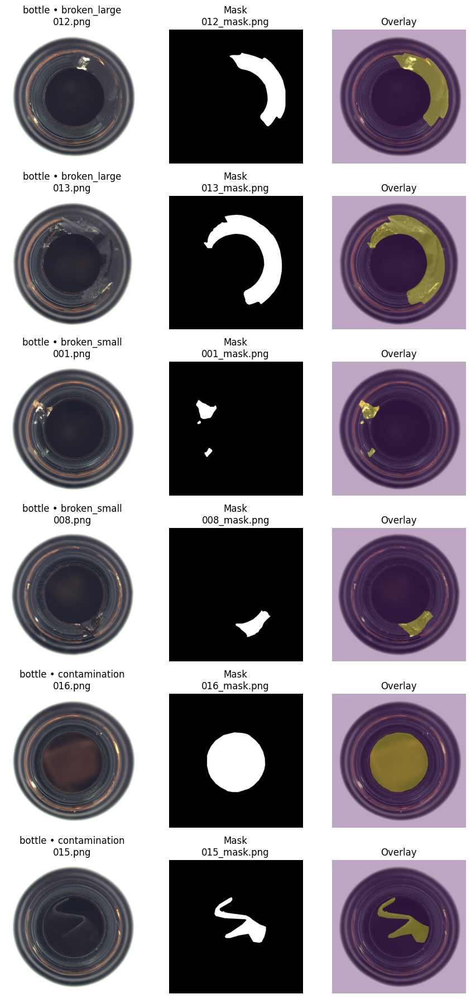


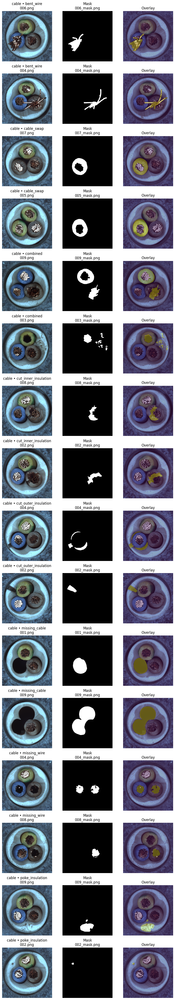


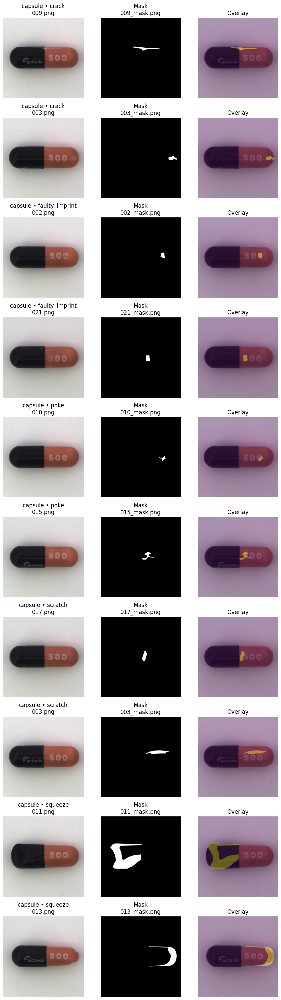


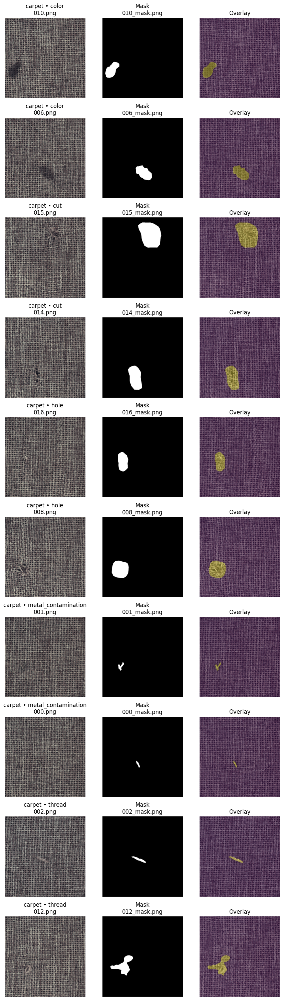


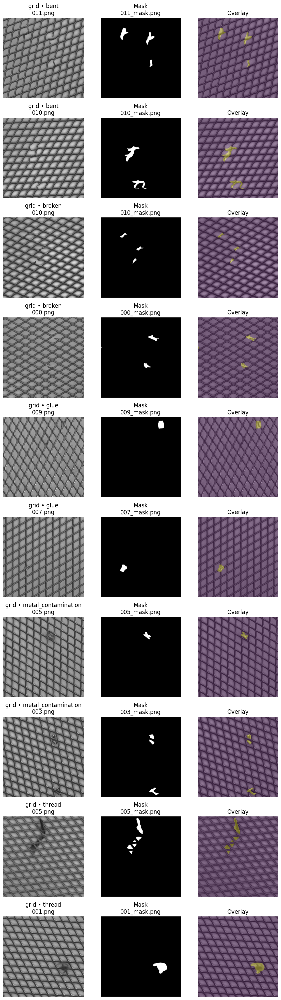


...


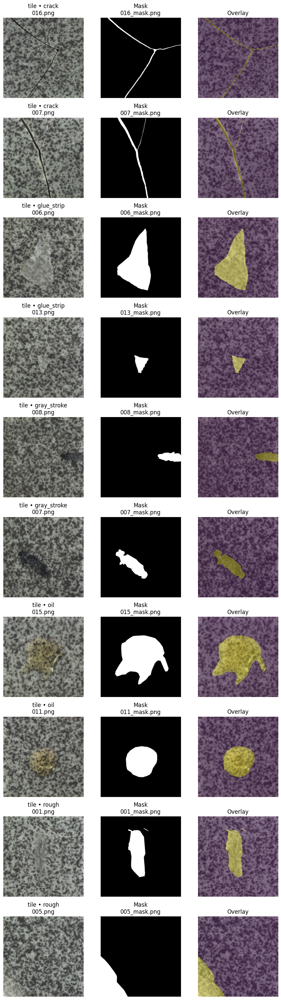


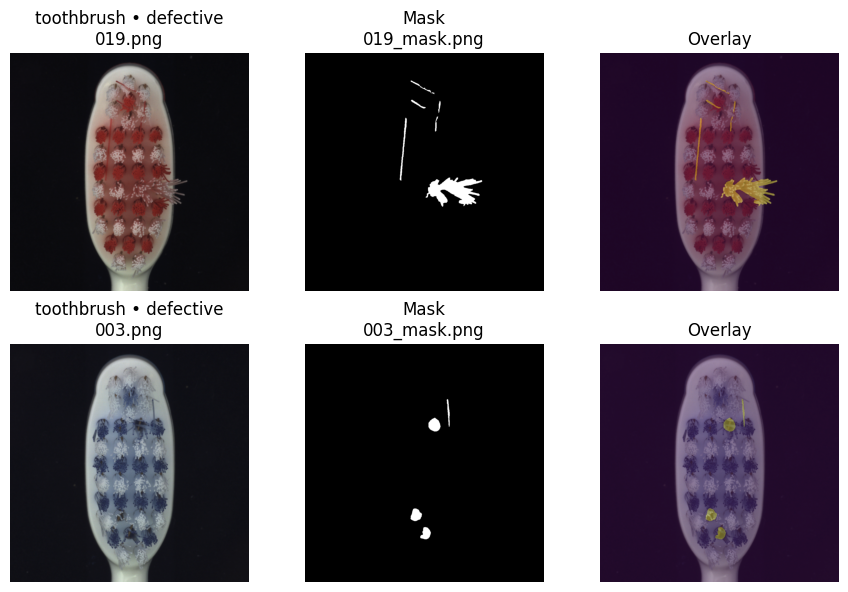


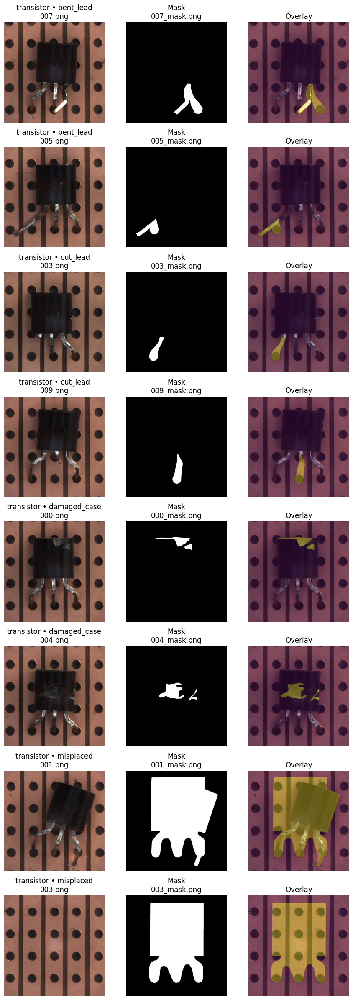


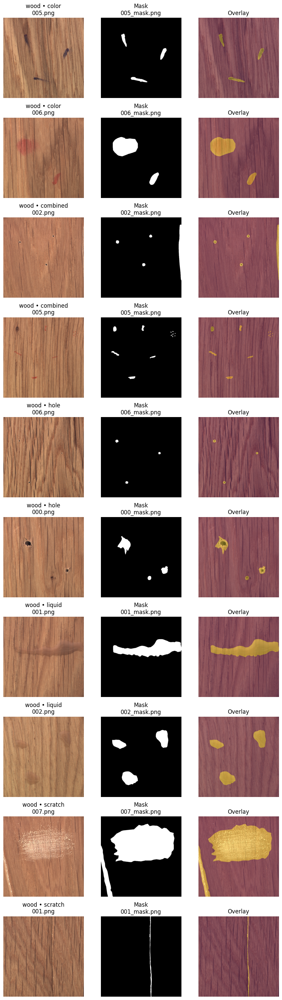


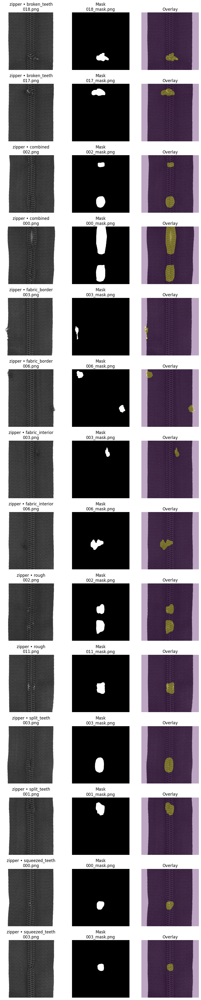

In [7]:
# ===== Chapter 4: Sample Visualization & Sanity Check (scrollable) =====
from pathlib import Path
import random
from typing import Dict, List, Tuple
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO
import base64
from IPython.display import HTML, display

# --- Config ---
N_PER_LABEL = 2        # how many samples per defect label to visualize
MAX_ROWS_TOTAL = 24    # safety cap to avoid huge figures per category
RANDOM_SEED = 0        # set to None to get different samples each run
SCROLLBOX_HEIGHT_PX = 800
CATEGORIES_TO_SHOW = None  # e.g. ['bottle','hazelnut'] or None for all

if RANDOM_SEED is not None:
    random.seed(RANDOM_SEED)

def load_image(path: Path) -> np.ndarray:
    """Load image as RGB uint8 numpy array."""
    img = Image.open(path).convert("RGB")
    return np.asarray(img)

def load_mask(path: Path) -> np.ndarray:
    """Load mask as binary uint8 numpy array (0/1)."""
    m = Image.open(path)
    m = np.asarray(m)
    if m.ndim == 3:
        m = m[..., 0]
    m = (m > 0).astype(np.uint8)
    return m

def collect_pairs_for_category(cat_root: Path) -> Dict[str, List[Tuple[Path, Path]]]:
    """
    Return: {label: [(img_path, mask_path), ...]} only for pairs with a matching stem.
    """
    img_by_label: Dict[str, Dict[str, Path]] = {}
    mask_by_label: Dict[str, Dict[str, Path]] = {}

    # Reuse iterators from Chapter 3
    for lbl, p in iter_defect_images(cat_root):
        img_by_label.setdefault(lbl, {})[image_stem(p)] = p
    for lbl, p in iter_masks(cat_root):
        mask_by_label.setdefault(lbl, {})[image_stem(p)] = p

    pairs: Dict[str, List[Tuple[Path, Path]]] = {}
    for lbl in sorted(set(img_by_label.keys()) | set(mask_by_label.keys())):
        imgs = img_by_label.get(lbl, {})
        msks = mask_by_label.get(lbl, {})
        common = sorted(set(imgs.keys()) & set(msks.keys()))
        pairs[lbl] = [(imgs[s], msks[s]) for s in common]
    return pairs

def visualize_samples_scrollable(cat: str, n_per_label: int = 2, max_rows_total: int = 24, height_px: int = 600):
    """
    Render samples for a category and wrap the figure in a scrollable HTML container.
    Shows three columns per sample: Image | Mask | Overlay.
    """
    cat_root = DATA_ROOT / cat
    if not cat_root.exists():
        print(f"[skip] Category not found: {cat}")
        return

    pairs = collect_pairs_for_category(cat_root)

    # Build a flat, sampled list across labels
    sampled: List[Tuple[str, Path, Path]] = []
    for lbl, lst in pairs.items():
        if not lst:
            continue
        k = min(n_per_label, len(lst))
        for img_p, msk_p in random.sample(lst, k=k):
            sampled.append((lbl, img_p, msk_p))

    if not sampled:
        print(f"[info] No (image, mask) pairs found for category '{cat}'.")
        return

    sampled = sampled[:max_rows_total]
    n_rows = len(sampled)

    # Create the figure
    fig, axes = plt.subplots(n_rows, 3, figsize=(9, 3 * n_rows))
    if n_rows == 1:
        axes = np.array([axes])  # normalize to 2D

    for r, (lbl, img_p, msk_p) in enumerate(sampled):
        img = load_image(img_p)
        msk = load_mask(msk_p)

        # Image
        ax = axes[r, 0]
        ax.imshow(img)
        ax.set_title(f"{cat} • {lbl}\n{img_p.name}")
        ax.axis("off")

        # Mask
        ax = axes[r, 1]
        ax.imshow(msk, cmap="gray")
        ax.set_title(f"Mask\n{msk_p.name}")
        ax.axis("off")

        # Overlay
        ax = axes[r, 2]
        ax.imshow(img)
        ax.imshow(msk, alpha=0.35)  # semi-transparent overlay
        ax.set_title("Overlay")
        ax.axis("off")

    plt.tight_layout()

    # Save the figure to an in-memory PNG
    buf = BytesIO()
    plt.savefig(buf, format="png", bbox_inches="tight")
    plt.close(fig)
    buf.seek(0)
    b64_img = base64.b64encode(buf.read()).decode()

    # Scrollable HTML container
    html = f"""
    <div style="border:1px solid #ccc; margin:8px 0; padding:6px;">
        <div style="font-family:monospace; margin-bottom:6px; color:#333;">=== {cat} ===</div>
        <div style="border:1px solid #ddd; overflow-y:scroll; height:{height_px}px;">
            <img src="data:image/png;base64,{b64_img}" />
        </div>
    </div>
    """
    display(HTML(html))

# ---- Run for categories ----
cats = [c for c in (CATEGORIES_TO_SHOW or categories) if c != ".ipynb_checkpoints"]
for cat in cats:
    visualize_samples_scrollable(
        cat,
        n_per_label=N_PER_LABEL,
        max_rows_total=MAX_ROWS_TOTAL,
        height_px=SCROLLBOX_HEIGHT_PX,
    )


**Conclusion:**  
The visual inspection confirmed that the ground truth masks accurately match the defect areas in the corresponding images.  
All sampled overlays showed correct alignment and complete coverage of the defective regions, with no visible mismatches or missing annotations.  
This validates the dataset’s mask quality and supports its use for subsequent training and evaluation steps.



## 5. Defect Size Distribution

In this step, we analyze the relative size of annotated defects by calculating the proportion of defect pixels within each mask, expressed as a percentage of the total image area.  
This quantitative measure provides insights into whether defects are predominantly small (e.g., fine scratches) or cover larger regions of the object.  
Understanding the typical defect size distribution is important for designing models with an appropriate receptive field, tuning patch sizes, and setting anomaly detection thresholds.



C:\Users\Fredi\AppData\Local\Temp\ipykernel_7544\3733547336.py:42: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([df_defects[df_defects["category"] == c]["defect_pct"] for c in order],


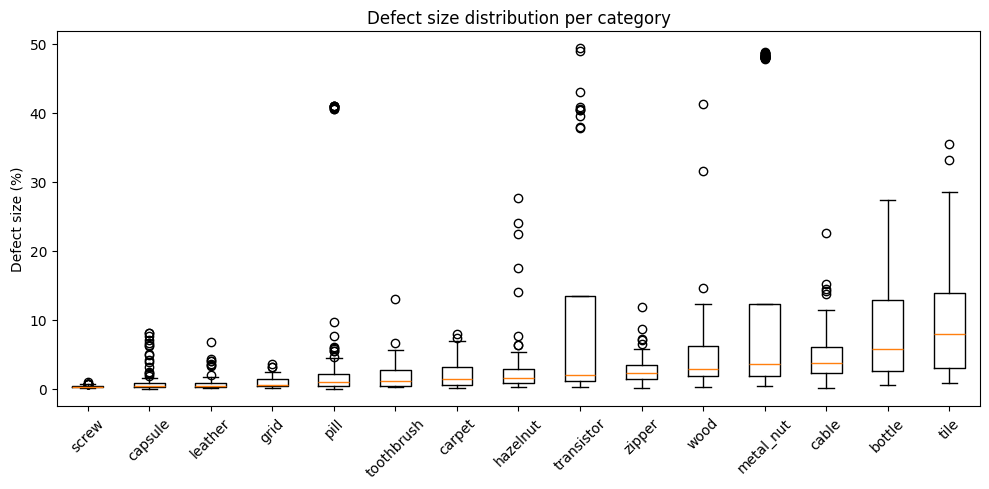

In [8]:
from pathlib import Path
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

def load_mask_binary(path: Path) -> np.ndarray:
    """Load a mask as binary uint8 array (0 = good, 1 = defect)."""
    m = Image.open(path)
    m = np.asarray(m)
    if m.ndim == 3:
        m = m[..., 0]
    return (m > 0).astype(np.uint8)

def defect_size_per_category(data_root: Path, categories: list[str]) -> pd.DataFrame:
    rows = []
    for cat in categories:
        if cat == ".ipynb_checkpoints":
            continue
        gt_root = data_root / cat / "ground_truth"
        if not gt_root.exists():
            continue
        for label_dir in sorted(gt_root.iterdir()):
            if not label_dir.is_dir():
                continue
            for mask_path in label_dir.glob("*.png"):
                mask = load_mask_binary(mask_path)
                defect_pct = mask.sum() / mask.size * 100
                rows.append({
                    "category": cat,
                    "label": label_dir.name,
                    "defect_pct": defect_pct
                })
    return pd.DataFrame(rows)

# --- Run ---
df_defects = defect_size_per_category(DATA_ROOT, categories)

# Boxplot for each category
plt.figure(figsize=(10, 5))
order = df_defects.groupby("category")["defect_pct"].median().sort_values().index
plt.boxplot([df_defects[df_defects["category"] == c]["defect_pct"] for c in order],
            labels=order, vert=True)
plt.ylabel("Defect size (%)")
plt.title("Defect size distribution per category")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


C:\Users\Fredi\AppData\Local\Temp\ipykernel_7544\2264457269.py:16: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([df_defects[df_defects["category"] == c]["defect_pct"] for c in order],


Min avg defect size: 0.34% (screw)
Max avg defect size: 14.49% (metal_nut)


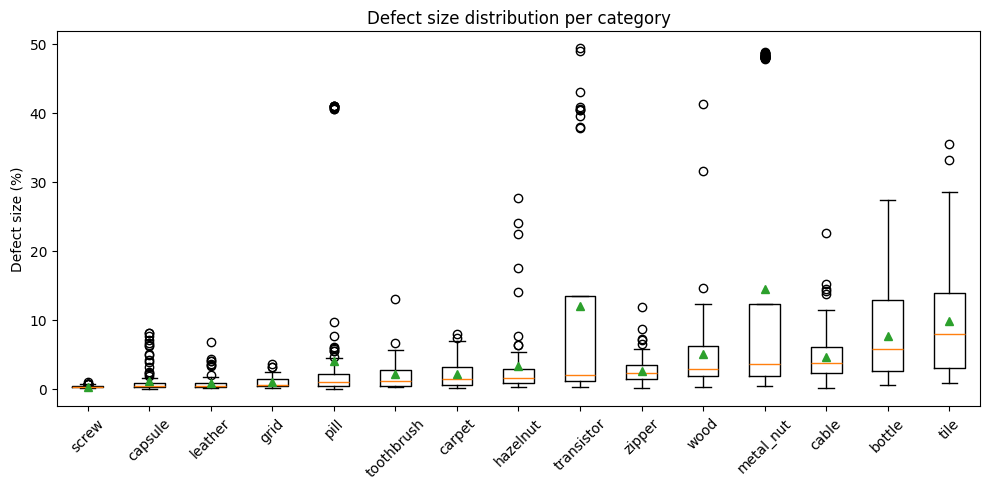

In [9]:
# --- Calculate mean values per category ---
mean_per_cat = df_defects.groupby("category")["defect_pct"].mean()

min_cat = mean_per_cat.idxmin()
min_val = mean_per_cat.min()

max_cat = mean_per_cat.idxmax()
max_val = mean_per_cat.max()

print(f"Min avg defect size: {min_val:.2f}% ({min_cat})")
print(f"Max avg defect size: {max_val:.2f}% ({max_cat})")

# --- Boxplot ---
plt.figure(figsize=(10, 5))
order = df_defects.groupby("category")["defect_pct"].median().sort_values().index
plt.boxplot([df_defects[df_defects["category"] == c]["defect_pct"] for c in order],
            labels=order, vert=True, showmeans=True)
plt.ylabel("Defect size (%)")
plt.title("Defect size distribution per category")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


**Summary:**  
The defect size analysis shows clear differences across categories.  
On average, *screw* has the smallest defects, covering only **0.34%** of the image area,  
while *metal_nut* has the largest, with an average of **14.49%**.  
Most categories are skewed towards small defect areas,  
while some — such as *transistor* and *metal_nut* — exhibit pronounced **outliers** with significantly larger damaged regions.  
These results indicate that models must be capable of detecting both fine-grained, localized anomalies and more extensive defects within the same dataset.



## 6. Visual Inspection of Extremes

**Goal.** While the previous chapter (Defect Size Distribution) provided a statistical overview of defect sizes across categories, this step focuses on direct visual inspection of the most extreme cases.  
By overlaying the defect masks on the corresponding images, we can quickly verify whether these outliers represent genuine edge cases (e.g., unusually small scratches or large area damages) or potential labelling issues.

**Method.**
1. For each category, select a small number of samples with the smallest and largest defect sizes (as computed in Chapter 5).
2. Overlay the defect mask onto the original image for easy visual comparison.
3. Review the results to decide whether these samples should be kept, flagged, or excluded from training.

**Why it matters.**
Visual inspection helps confirm whether statistically identified outliers are valid.  
It also provides intuition for the diversity of defect appearances, which can influence augmentation strategies and model robustness.



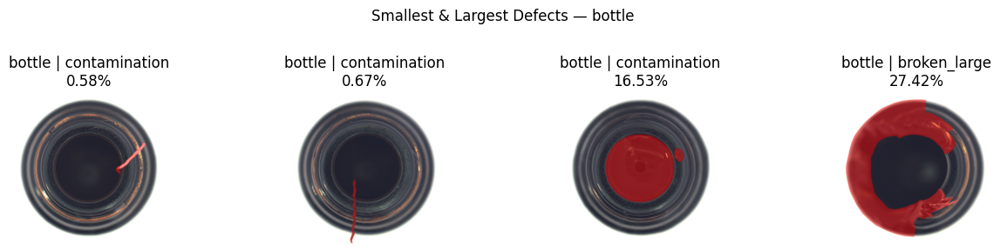

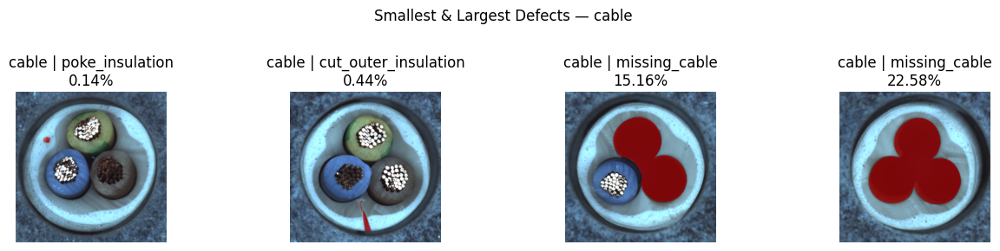

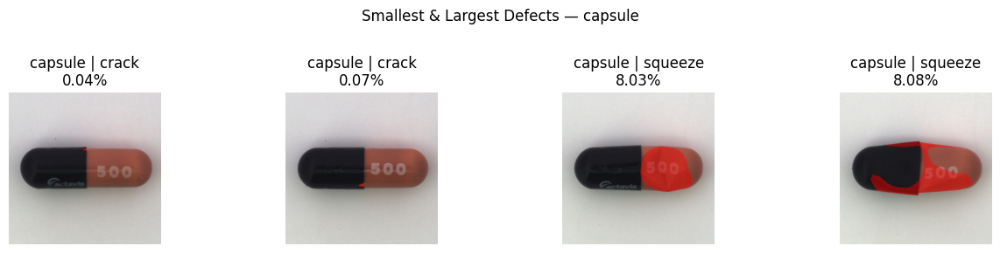

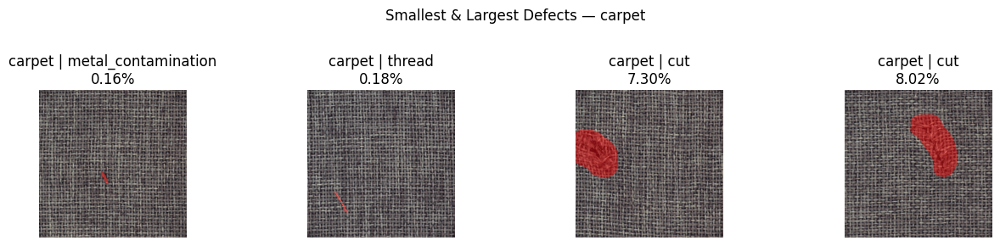

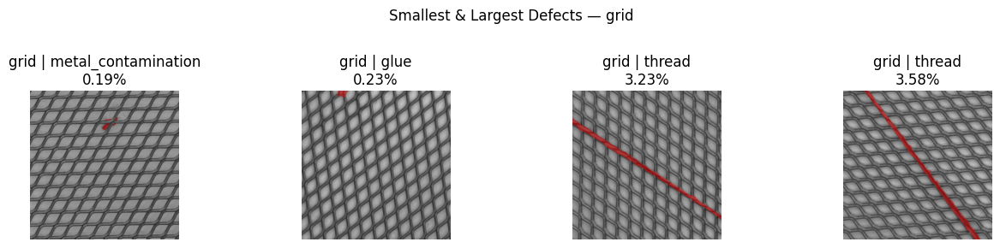

...

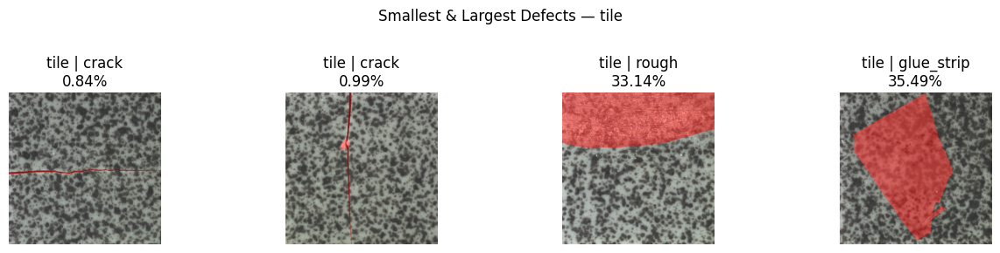

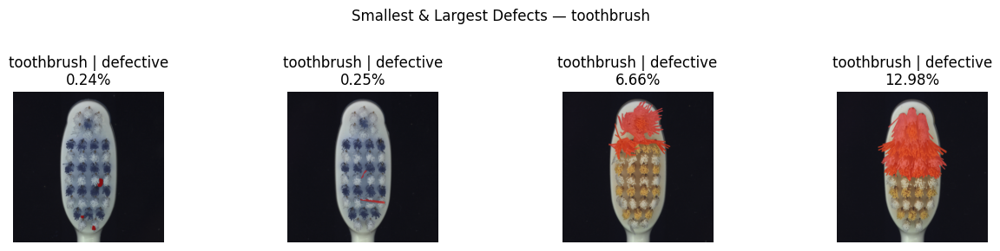

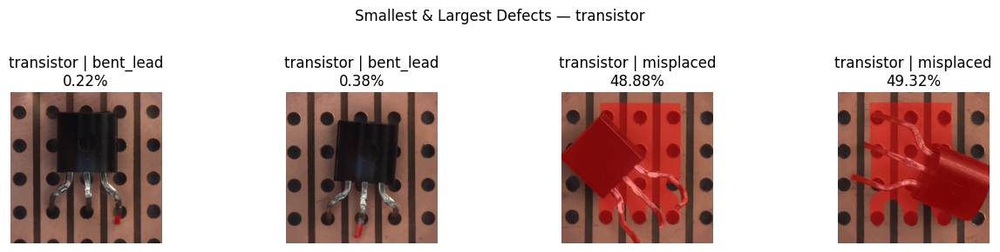

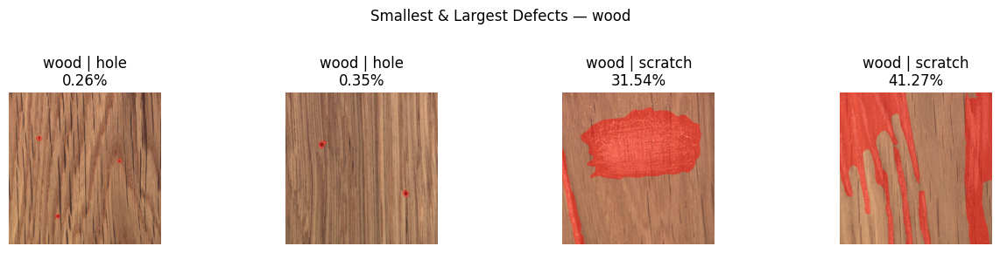

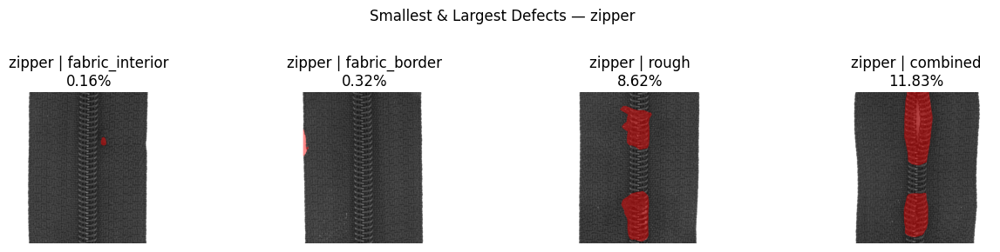

In [10]:
# ===== Chapter 6: Visual Inspection of Extremes =====
# Select smallest and largest defect sizes per category and visualize mask overlays

from pathlib import Path
from typing import Iterable, Tuple, Dict, List
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

# --- Config ---
try:
    DATA_ROOT
except NameError:
    DATA_ROOT = Path("../data/mvtec").resolve()

IMG_EXTS = {".png", ".jpg", ".jpeg"}

# --- Helpers: image/mask loading and pairing (MVTec AD layout) ---
def load_image_rgb(path: Path) -> np.ndarray:
    """Load image as RGB uint8 [H,W,3]."""
    return np.asarray(Image.open(path).convert("RGB"))

def load_mask_binary(path: Path) -> np.ndarray:
    """Load mask as binary uint8 [0,1] with shape [H,W]. Robust to RGB/RGBA masks."""
    m = np.asarray(Image.open(path))
    if m.ndim == 3:
        m = m[..., 0]
    return (m > 0).astype(np.uint8)

def iter_test_defect_images(cat_root: Path):
    """
    Yield (img_path, mask_path, category, defect_label, stem) for test/defect images that have masks.
    Mask pattern in MVTec: ground_truth/<label>/<stem>_mask.png
    """
    category = cat_root.name
    test_dir = cat_root / "test"
    gt_dir = cat_root / "ground_truth"
    if not test_dir.exists() or not gt_dir.exists():
        return
    for defect_dir in sorted([d for d in test_dir.iterdir() if d.is_dir() and d.name != "good"]):
        label = defect_dir.name
        for img_path in sorted(p for p in defect_dir.rglob("*") if p.suffix.lower() in IMG_EXTS):
            stem = img_path.stem
            mask_path = gt_dir / label / f"{stem}_mask.png"
            if mask_path.exists():
                yield img_path, mask_path, category, label, stem

def compute_defect_size_df(data_root: Path) -> pd.DataFrame:
    """Compute per-image defect percentage for all categories (test split with masks)."""
    rows = []
    for cat_dir in sorted([d for d in data_root.iterdir() if d.is_dir() and d.name != ".ipynb_checkpoints"]):
        for img_path, mask_path, category, label, stem in iter_test_defect_images(cat_dir):
            mask = load_mask_binary(mask_path)
            h, w = mask.shape
            pct = 100.0 * mask.sum() / float(h * w)
            rows.append({
                "category": category,
                "label": label,
                "img_path": str(img_path),
                "mask_path": str(mask_path),
                "height": h,
                "width": w,
                "defect_pct": pct
            })
    return pd.DataFrame(rows)

# Reuse df_defect_size from Chapter 5 if present; otherwise compute now.
try:
    df_defect_size
    assert isinstance(df_defect_size, pd.DataFrame)
except Exception:
    df_defect_size = compute_defect_size_df(DATA_ROOT)

# --- Selection: smallest and largest defects per category ---
def select_extremes(df: pd.DataFrame, category: str, k_small: int = 2, k_large: int = 2) -> pd.DataFrame:
    """Return a small dataframe with the k smallest and k largest defect_pct samples for a category."""
    dfc = df[df["category"] == category].sort_values("defect_pct")
    if dfc.empty:
        return dfc
    picks = pd.concat([dfc.head(k_small), dfc.tail(k_large)], axis=0)
    # Keep order: smallest first, then largest
    return picks.reset_index(drop=True)

# --- Visualization: overlay mask on image ---
def overlay_with_mask(img: np.ndarray, mask: np.ndarray, alpha: float = 0.45) -> np.ndarray:
    """
    Create an overlay where mask area is tinted red.
    img: uint8 [H,W,3], mask: uint8 [H,W] with {0,1}
    """
    h, w = mask.shape
    assert img.shape[0] == h and img.shape[1] == w, "Image and mask need same spatial size."
    overlay = img.astype(np.float32)
    red = np.zeros_like(overlay)
    red[..., 0] = 255  # red channel
    mask3 = np.stack([mask]*3, axis=-1).astype(bool)
    out = np.where(mask3, (1 - alpha) * overlay + alpha * red, overlay)
    return out.astype(np.uint8)

def show_extremes_for_category(category: str, k_small: int = 2, k_large: int = 2, suptitle: bool = True):
    """Plot smallest and largest defect samples for a given category with mask overlays."""
    picks = select_extremes(df_defect_size, category, k_small=k_small, k_large=k_large)
    n = len(picks)
    if n == 0:
        print(f"No defect samples for category '{category}'.")
        return
    cols = min(4, n)
    rows = int(np.ceil(n / cols))
    plt.figure(figsize=(3.2*cols, 2.8*rows))
    for i, r in enumerate(picks.itertuples(index=False), start=1):
        img = load_image_rgb(Path(r.img_path))
        msk = load_mask_binary(Path(r.mask_path))
        overlay = overlay_with_mask(img, msk, alpha=0.45)
        plt.subplot(rows, cols, i)
        plt.imshow(overlay)
        plt.title(f"{category} | {r.label}\n{r.defect_pct:.2f}%")
        plt.axis("off")
    if suptitle:
        plt.suptitle(f"Smallest & Largest Defects — {category}", y=1.02)
    plt.tight_layout()
    plt.show()

def show_extremes_for_categories(categories: Iterable[str], k_small: int = 2, k_large: int = 2):
    """Convenience: loop multiple categories."""
    for c in categories:
        show_extremes_for_category(c, k_small=k_small, k_large=k_large)

# Show extremes for all categories
all_cats = sorted(df_defect_size["category"].unique())
show_extremes_for_categories(all_cats, k_small=2, k_large=2)


**Conclusion**

In this chapter, we visually inspected the most extreme defect sizes for each category by overlaying the ground-truth masks onto the original images.  
For every category, the two smallest and two largest defects (in terms of defect pixel percentage) were selected, regardless of defect type.  
This allowed us to quickly verify whether statistical outliers from the previous chapter correspond to genuine anomalies or potential labelling errors.  
In some cases, all selected extremes came from the same defect type, which indicates that certain defect types dominate the extremes within their category.



## 7. Image Similarity & Clustering

**Goal.**  
In this step, we explore the visual similarity between images across all categories by extracting high-level feature embeddings from a pre-trained convolutional or transformer-based model (e.g., ResNet50, DINOv2).  
These embeddings capture semantic image characteristics and allow us to visualize relationships between samples in a low-dimensional space.

**Method.**  
1. Load a pre-trained model and remove its classification head to obtain feature vectors for each image.  
2. Apply the same base transforms used in training to ensure consistent input sizes and normalization.  
3. Reduce the dimensionality of the feature vectors using t-SNE or UMAP.  
4. Plot the reduced embeddings, coloring points by their category or defect type.

**Why it matters.**  
Visualizing image similarity can reveal clusters of related defects, highlight overlaps between *good* and defective samples, and help identify potential mislabelled images.  
This insight is valuable for both dataset curation and model design decisions.


In [11]:
# === ResNet50 embeddings without classification head ===
from pathlib import Path
from typing import List, Dict
import numpy as np
import torch
import torch.nn as nn
from PIL import Image

# 1) Load pretrained ResNet50
try:
    from torchvision.models import resnet50, ResNet50_Weights
    model = resnet50(weights=ResNet50_Weights.IMAGENET1K_V1)
except Exception:
    # Older torchvision fallback
    import torchvision.models as models
    model = models.resnet50(pretrained=True)

# 2) Remove classification head → keep backbone up to avgpool
#    Output shape from this module is [B, 2048, 1, 1] → we'll flatten to [B, 2048]
backbone = nn.Sequential(*(list(model.children())[:-1]))
backbone.eval()
for p in backbone.parameters():
    p.requires_grad = False

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
backbone = backbone.to(device)

# 3) Use your Chapter 0 base_transforms if available; otherwise define a safe default
try:
    base_transforms
    _ = base_transforms  # just to check existence
except NameError:
    base_transforms = None

if base_transforms is None:
    # Fallback: imagenet-size + normalization
    from torchvision import transforms
    BASE_SIZE = (256, 256)
    base_transforms = transforms.Compose([
        transforms.Resize(BASE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225]),
    ])

# 4) Helper to embed one image path → 2048-d numpy vector
def embed_image(path: Path) -> np.ndarray:
    img = Image.open(path).convert("RGB")
    x = base_transforms(img).unsqueeze(0).to(device)   # [1,3,H,W]
    with torch.no_grad():
        f = backbone(x)                                # [1,2048,1,1]
        f = torch.flatten(f, 1)                        # [1,2048]
    return f.squeeze(0).cpu().numpy()                  # [2048]

# 5) Batch helper for many images (keeps memory modest)
def embed_paths(paths: List[Path], batch_size: int = 32) -> np.ndarray:
    vecs = []
    batch = []
    for p in paths:
        img = Image.open(p).convert("RGB")
        x = base_transforms(img)                       # [3,H,W]
        batch.append(x)
        if len(batch) == batch_size:
            xb = torch.stack(batch, dim=0).to(device)  # [B,3,H,W]
            with torch.no_grad():
                f = backbone(xb)                       # [B,2048,1,1]
                f = torch.flatten(f, 1)                # [B,2048]
            vecs.append(f.cpu().numpy())
            batch = []
    if batch:
        xb = torch.stack(batch, dim=0).to(device)
        with torch.no_grad():
            f = backbone(xb)
            f = torch.flatten(f, 1)
        vecs.append(f.cpu().numpy())
    return np.concatenate(vecs, axis=0) if vecs else np.zeros((0, 2048), dtype=np.float32)



In [12]:
# === Build embeddings table for the whole dataset ===
from pathlib import Path
import itertools
import pandas as pd

try:
    DATA_ROOT
except NameError:
    DATA_ROOT = Path("../data/mvtec").resolve()

IMG_EXTS = {".png", ".jpg", ".jpeg"}

def iter_all_images(root: Path):
    """
    Yields dictionaries with: path, category, split (train/test), label_dir (e.g., 'good','scratch'…),
    super_label ('good' or 'defect'), defect_type (None for 'good')
    """
    for cat_dir in sorted([d for d in root.iterdir() if d.is_dir() and d.name != ".ipynb_checkpoints"]):
        for split in ("train", "test"):
            split_dir = cat_dir / split
            if not split_dir.exists():
                continue
            for label_dir in sorted([d for d in split_dir.iterdir() if d.is_dir()]):
                lbl = label_dir.name
                super = "good" if lbl == "good" else "defect"
                defect_type = None if lbl == "good" else lbl
                for p in label_dir.rglob("*"):
                    if p.suffix.lower() in IMG_EXTS:
                        yield {
                            "path": p,
                            "category": cat_dir.name,
                            "split": split,
                            "label_dir": lbl,
                            "label": super,          # 'good' / 'defect'
                            "defect_type": defect_type
                        }

# 1) Collect paths & metadata
rows = list(iter_all_images(DATA_ROOT))
paths = [r["path"] for r in rows]
print(f"Found {len(paths)} images.")

# 2) Compute embeddings (uses your previously defined embed_paths / backbone / base_transforms)
X = embed_paths(paths, batch_size=64)   # -> shape [N, 2048] for ResNet50
print("Embeddings:", X.shape)

# 3) Build DataFrame (metadata + embedding as object column)
df_embed = pd.DataFrame(rows)
df_embed["embedding"] = [vec for vec in X]  # each row: np.ndarray(2048,)
df_embed.head()


Found 5354 images.
Embeddings: (5354, 2048)


,path,category,split,label_dir,label,defect_type,embedding
0,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\000.png,bottle,train,good,good,None,"[0.813157, 0.30758733, 0.09653197, 0.021058789, 1.2871985, 0.46995205, 0.5217715, 1.3622724, 0.8608533, 0.12563913, 0.01438516, 0.1702496, 0.35334074, 0.42475495, 0.104195625, 0.628203, 0.0012038257, 0.17720357, 0.17714238, 0.99503475, 0.5540939, 1.03648, 0.4987354, 0.07313559, 0.7603521, 0.24254158, 1.4351906, 0.25991565, 0.29438612, 0.45745346, 1.0382745, 1.1448754, 1.5388049, 0.08160688, 0.19836538, 0.10842611, 0.20132715, 0.45911962, 0.06615497, 0.043632302, 0.6646689, 1.8260305, 0.7668266, 0.068016194, 0.20817158, 0.15749523, 0.002480109, 2.2085676, 0.23150927, 0.0062219035, 0.019057725, 0.50379133, 0.42817205, 0.04311352, 0.0052802665, 0.56618196, 0.020349156, 0.59279805, 0.5710484, 0.57900864, 0.7925973, 0.036660995, 2.3130503, 0.22417638, 0.11718148, 1.9711583, 0.6653048, 0.0023976837, 0.105441794, 0.31030652, 0.67348665, 0.031523716, 0.37006187, 0.41561767, 0.031672917, 0.093777195, 0.14029038, 1.4196986, 1.4206285, 0.047383957, 0.09885914, 0.11696896, 0.13636741, 0.4461693, 0.0005294732, 0.86345005, 0.4858979, 0.6427061, 0.36999837, 0.22633114, 0.22619513, 0.0, 0.0733769, 0.32625556, 0.4572141, 0.64672625, 1.6817735, 0.06584836, 0.7680744, 1.0876529, ...]"
1,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\001.png,bottle,train,good,good,None,"[0.88737166, 0.48044303, 0.028087623, 0.02451953, 1.3772006, 0.6318373, 0.61467284, 1.55969, 0.970678, 0.105343685, 0.043513976, 0.14859675, 0.23999286, 0.45340896, 0.17141, 0.7385939, 2.9351795e-05, 0.16956124, 0.17368871, 0.960309, 0.4960417, 1.050158, 0.5994742, 0.025207296, 0.74750626, 0.10722533, 1.5197061, 0.45571965, 0.42213994, 0.29734072, 0.9967292, 1.0004445, 1.6143907, 0.14844121, 0.22667709, 0.10840695, 0.19296268, 0.5630886, 0.044430606, 0.12394591, 0.68786716, 1.7759469, 0.69595146, 0.0796727, 0.1943762, 0.09678325, 0.0023958401, 2.3860736, 0.19239824, 0.0063551534, 0.0067873662, 0.48231333, 0.4975448, 0.09033999, 0.0074914116, 1.0085089, 0.02212268, 0.358156, 0.6770141, 0.6950037, 0.6457725, 0.033111207, 2.8006895, 0.4171382, 0.17797637, 1.9371618, 0.54748875, 0.0066033434, 0.1733847, 0.3740459, 0.71389455, 0.015525349, 0.5280587, 0.39898416, 0.07456021, 0.124153465, 0.12266365, 1.349502, 1.4217861, 0.0133965565, 0.09542121, 0.098807074, 0.056689817, 0.57191837, 0.0037046855, 0.78514874, 0.323074, 0.65981436, 0.4453404, 0.34745038, 0.24576844, 0.0, 0.0638859, 0.38094383, 0.4186537, 0.44365054, 2.0749342, 0.05856712, 1.026074, 1.2277331, ...]"
2,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\002.png,bottle,train,good,good,None,"[0.7591796, 0.551202, 0.09039561, 0.06932337, 1.3769165, 0.35759282, 0.6401373, 1.8617625, 1.0458949, 0.13033445, 0.03984826, 0.088187516, 0.17115667, 0.32523087, 0.2267859, 0.4012908, 0.0, 0.14164238, 0.32238942, 0.8390318, 0.38810894, 1.3481878, 0.4364378, 0.05540308, 0.7470895, 0.16344172, 1.2910311, 0.43435055, 0.40309048, 0.4885287, 1.0059054, 0.723829, 1.4178792, 0.08710178, 0.26878202, 0.186704, 0.12875964, 0.5899079, 0.05535525, 0.04175096, 0.5812849, 1.4249277, 0.657925, 0.042773783, 0.25858158, 0.220707, 0.0055551366, 2.1712556, 0.2374399, 0.006397307, 0.019513696, 0.3946349, 0.3806741, 0.0993126, 0.007868977, 0.9037423, 0.016502248, 0.3938545, 0.52367514, 0.7313081, 0.58114094, 0.009787498, 2.8620028, 0.30466574, 0.14247502, 1.5445565, 0.5635709, 0.000105843705, 0.18212357, 0.37126043, 0.46534032, 0.036164027, 0.6036243, 0.32961947, 0.08021784, 0.08948172, 0.11317839, 1.2244803, 1.0493913, 0.02402113, 0.075147465, 0.12183553, 0.15609819, 0.48232666, 0.03011055, 0.8526275, 0.5188851, 0.9131347, 0.25381544, 0.2783101, 0.2984701, 0.0009108032, 0.065934025, 0.39518413, 0.34351486, 0.33802626, 2.2488945, 0.062005997, 1.116816, 0.7547945, ...]"
3,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\003.png,bottle,train,good,good,None,"[0.64066374, 0.5427925, 0.13352112, 0.059667, 1.4270855,

In [13]:
# Save embeddings + metadata
import numpy as np
out_npz = DATA_ROOT.parent / "mvtec_embeddings_resnet50.npz"
np.savez_compressed(out_npz, embeddings=X, meta=df_embed.drop(columns=["embedding"]).to_dict(orient="list"))
print("Saved to:", out_npz)




Saved to: C:\Users\Fredi\MVTec\data\mvtec_embeddings_resnet50.npz


### Feature Extraction with ResNet

For this analysis, a pre-trained ResNet model was used to extract high-level features from the images.  
A ResNet consists of two main parts:

1. **Feature extractor (convolutional backbone)**  
   - Multiple convolutional and pooling layers that process the image and detect visual patterns such as edges, textures, shapes, and more complex structures in deeper layers.

2. **Classification head (fully connected layer)**  
   - A dense layer that takes the extracted features and outputs class probabilities (e.g., 1000 categories in ImageNet).

To obtain embeddings instead of classification results, the classification head was removed ("cut off").  
The model was then used in *feature extraction mode*, where the convolutional backbone outputs a high-dimensional feature vector for each image (e.g., 2048 dimensions for ResNet50).

These **feature vectors (embeddings)**:
- Represent the visual characteristics of each image in a compact numerical form.
- Place visually similar images closer together in the high-dimensional space.

The extracted embeddings form the basis for all subsequent analysis steps.  
In later stages, dimensionality reduction methods such as PCA, UMAP, and t-SNE, as well as clustering algorithms like K-Means, are applied to these embeddings to explore their structure and class separability.


### 7.1 Load & Preparation

In this step, we load the previously saved `.npz` file containing:

- **Embeddings** → the 2048-dimensional feature vectors extracted from ResNet50 (one per image).  
- **Metadata** → image path, category, split, label, and defect type.

We then:

1. **Load** both arrays from disk into memory.
2. **Verify** that the number of embeddings matches the number of metadata rows.
3. **Prepare** the data for analysis:
   - Store embeddings in `X` (NumPy array).
   - Store metadata in a `pandas` DataFrame (`meta`).

This provides a clean starting point for dimensionality reduction, clustering, and similarity search.


In [14]:
# === Load embeddings & metadata from NPZ ===
from pathlib import Path
import numpy as np
import pandas as pd

DATA_ROOT = Path("../data/mvtec").resolve()
in_npz = DATA_ROOT.parent / "mvtec_embeddings_resnet50.npz"

npz = np.load(in_npz, allow_pickle=True)
X = npz["embeddings"]                # shape [N, 2048]
meta = pd.DataFrame(npz["meta"].item())  # dict → DataFrame
assert len(X) == len(meta), "Embeddings and metadata length mismatch"
print(X.shape, meta.shape)
meta.head()


(5354, 2048) (5354, 6)


,path,category,split,label_dir,label,defect_type
0,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\000.png,bottle,train,good,good,None
1,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\001.png,bottle,train,good,good,None
2,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\002.png,bottle,train,good,good,None
3,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\003.png,bottle,train,good,good,None
4,C:\Users\Fredi\MVTec\data\mvtec\bottle\train\good\004.png,bottle,train,good,good,None


### 7.2 Standardization + PCA (Speeds up t-SNE/UMAP)

Before applying UMAP or t-SNE, it is often beneficial to preprocess the embeddings:

1. **Standardization**  
   - Scale each feature to have zero mean and unit variance.  
   - Ensures that all embedding dimensions contribute equally to distance calculations.

2. **PCA (Principal Component Analysis)**  
   - Reduces the number of dimensions while retaining most of the variance (e.g., 95%).  
   - Helps remove noise and redundant features.  
   - Greatly improves the speed and stability of t-SNE and UMAP.

**Why this step matters:**  
- High-dimensional data can contain noise that makes low-dimensional projections unstable.  
- Standardization + PCA produces a cleaner, more compact representation that preserves the global structure, making visualization methods more effective and faster.


In [15]:
# === Standardize + PCA (optional but recommended) ===
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# 1) Standardize embeddings
scaler = StandardScaler(with_mean=True, with_std=True)
X_std = scaler.fit_transform(X)

# 2) PCA to ~95% variance (or a fixed dim like 100)
pca = PCA(n_components=0.95, svd_solver="full", random_state=0)
X_pca = pca.fit_transform(X_std)
print("PCA shape:", X_pca.shape, "explained var:", pca.explained_variance_ratio_.sum())


PCA shape: (5354, 102) explained var: 0.95009655


**PCA Result:**

- **Original dimension:** 2048 (ResNet50 embedding size)  
- **After PCA:** 102 dimensions  
- **Explained variance:** 0.9501 (≈ 95.01%)

**Interpretation:**  
PCA reduced the feature space from 2048 to **102 components** while still preserving about **95%** of the total variance in the data.  
This means that most of the important information is retained, while redundant and low-variance dimensions are removed.  
The resulting embeddings are more compact, less noisy, and will make subsequent steps like UMAP/t-SNE faster and more stable.


### 7.3 2D Projection (UMAP or t-SNE)

In this step, the high-dimensional embeddings (after PCA) are projected into **two dimensions** for visualization.  
Methods like **UMAP** or **t-SNE** preserve the structure of the data so that similar images stay close together in the 2D plot, making clusters, patterns, and outliers easier to spot.


### Dimensionality Reduction with UMAP and t-SNE

After extracting high-dimensional embeddings from the images, two non-linear dimensionality reduction methods were applied to project the data into a 2D space for visualization and exploratory analysis: **UMAP** (Uniform Manifold Approximation and Projection) and **t-SNE** (t-Distributed Stochastic Neighbor Embedding).

- **t-SNE**  
  - Focuses on preserving **local structure**: points that are close in the high-dimensional space remain close in the 2D projection.  
  - Often produces **tightly grouped and visually distinct clusters**, but does not preserve global distances between clusters.  
  - Well-suited for datasets where clear separation between groups is more important than understanding the overall layout.

- **UMAP**  
  - Preserves both **local** and, to some extent, **global** structure of the data.  
  - Offers more control through parameters such as `n_neighbors` (influences cluster separation) and `min_dist` (controls cluster density).  
  - Can be significantly faster than t-SNE and is able to transform new data points after fitting, making it suitable for pipelines.

In this project, both methods were used to visualize how well the extracted embeddings separate the classes (good vs. defect) and to identify regions where the two labels overlap.  
Such 2D projections help in assessing the quality of the learned feature space before applying clustering or classification algorithms.


In [29]:
# === 7.3a: Compute 2D projections with UMAP and t-SNE ===
import numpy as np
import pandas as pd
import time

# X_pca: your PCA-reduced embeddings (e.g., shape [N, 102])
# meta:  your metadata DataFrame (same order as X_pca)

# --- UMAP ---
try:
    import umap
except ModuleNotFoundError:
    raise ModuleNotFoundError("Please install UMAP: `pip install umap-learn`")

t0 = time.time()
umap2d = umap.UMAP(
    n_components=2,
    n_neighbors=70,
    #n_neighbors=15,   # 10–50: higher = more global structure, lower = more local
    min_dist=0.3,     # 0.0–0.5: smaller = tighter clusters
    metric="euclidean",
    random_state=0
)
Z_umap = umap2d.fit_transform(X_pca)
t_umap = time.time() - t0
print(f"UMAP done in {t_umap:.1f}s → shape {Z_umap.shape}")

# --- t-SNE (keep it practical) ---
import numpy as np
from sklearn.manifold import TSNE

N = X_pca.shape[0]
# Perplexity heuristic: ~sqrt(N), clipped to [5, 50]
perp = int(np.clip(np.sqrt(N), 5, 50))

tsne = TSNE(
    n_components=2,
    init="pca",
    perplexity=perp,
    learning_rate="auto",      # supported in 1.7.1
    early_exaggeration=12.0,
    max_iter=850,              # <-- use max_iter here
    random_state=0,
    verbose=1,
    method="barnes_hut",       # default for n_components=2
    angle=0.5                  # trade-off speed/accuracy (0.2 more accurate, 0.8 faster)
)

Z_tsne = tsne.fit_transform(X_pca)
print(f"t-SNE shape: {Z_tsne.shape} (perplexity={perp}, max_iter=850)")


# Store results for later reuse
df_proj = meta.copy()
df_proj["umap_x"] = Z_umap[:, 0]
df_proj["umap_y"] = Z_umap[:, 1]
if Z_tsne is not None:
    df_proj["tsne_x"] = Z_tsne[:, 0]
    df_proj["tsne_y"] = Z_tsne[:, 1]



C:\Users\Fredi\MVTec\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
C:\Users\Fredi\MVTec\.venv\Lib\site-packages\sklearn\manifold\_spectral_embedding.py:328: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


UMAP done in 10.0s → shape (5354, 2)
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 5354 samples in 0.001s...
[t-SNE] Computed neighbors for 5354 samples in 0.148s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5354
[t-SNE] Computed conditional probabilities for sample 2000 / 5354
[t-SNE] Computed conditional probabilities for sample 3000 / 5354
[t-SNE] Computed conditional probabilities for sample 4000 / 5354
[t-SNE] Computed conditional probabilities for sample 5000 / 5354
[t-SNE] Computed conditional probabilities for sample 5354 / 5354
[t-SNE] Mean sigma: 4.609727
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.207195
[t-SNE] KL divergence after 850 iterations: 0.702646
t-SNE shape: (5354, 2) (perplexity=50, max_iter=850)


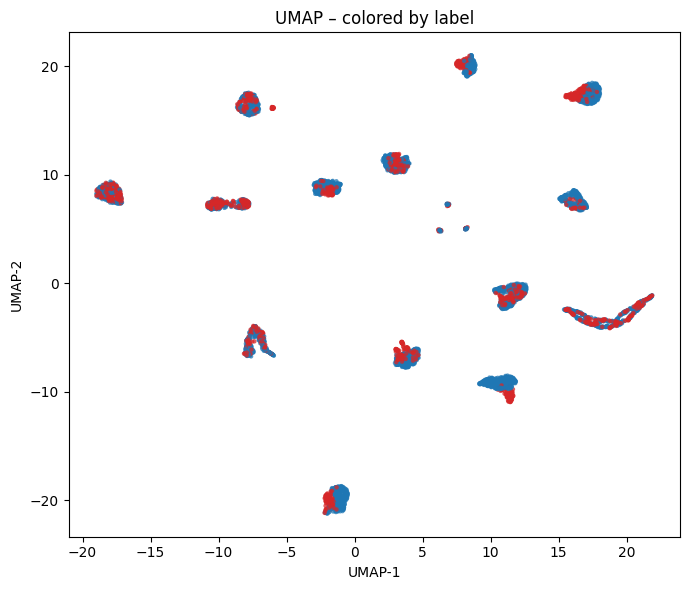

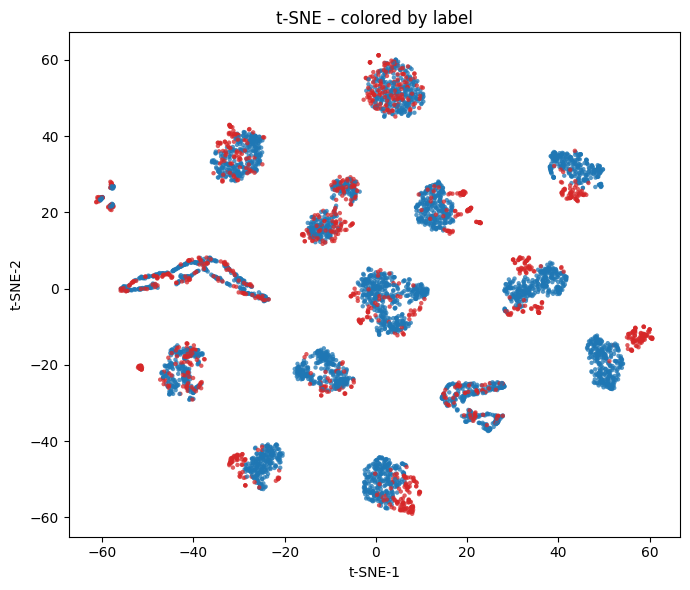

In [30]:
# === 7.3b: Plot UMAP and t-SNE (colored by label or category) ===
import matplotlib.pyplot as plt

# Choose coloring: 'label' ("good"/"defect") or 'category'
color_col = "label"  # change to "category" if you prefer

def make_colors(series):
    if series.nunique() <= 10 and series.name == "label":
        mapping = {"good": "tab:blue", "defect": "tab:red"}
        return series.map(mapping).fillna("tab:gray")
    # categorical palette
    cats = series.astype("category")
    cmap = plt.get_cmap("tab20")
    return cats.cat.codes.map(lambda i: cmap(i % 20))

# --- UMAP plot ---
colors = make_colors(df_proj[color_col])
plt.figure(figsize=(7,6))
plt.scatter(df_proj["umap_x"], df_proj["umap_y"], s=10, c=colors, alpha=0.75, linewidths=0)
plt.title(f"UMAP – colored by {color_col}")
plt.xlabel("UMAP-1"); plt.ylabel("UMAP-2")
plt.tight_layout()
plt.show()

# --- t-SNE plot (if available) ---
if "tsne_x" in df_proj.columns:
    colors = make_colors(df_proj[color_col])
    plt.figure(figsize=(7,6))
    plt.scatter(df_proj["tsne_x"], df_proj["tsne_y"], s=10, c=colors, alpha=0.75, linewidths=0)
    plt.title(f"t-SNE – colored by {color_col}")
    plt.xlabel("t-SNE-1"); plt.ylabel("t-SNE-2")
    plt.tight_layout()
    plt.show()
else:
    print("t-SNE coordinates not available (skipped).")


### Observations from 2D Projections

Both UMAP and t-SNE provide a visual representation of the high-dimensional embeddings in a 2D space.  
In the scatter plots, each point corresponds to an image, and the color indicates its label (good = blue, defect = red).

**Key observations:**
- **Cluster separation:**  
  - In some regions, red (defect) and blue (good) points are clearly separated, indicating that the embedding space distinguishes these cases well.  
  - In other areas, colors are mixed, suggesting that certain defects share visual features with good samples or that the embedding space does not fully separate them.
- **UMAP vs. t-SNE:**  
  - UMAP parameters were tuned to make the 15 class clusters visible; however, with `min_dist = 0.3` the clusters appear less compact and less cleanly separated than with t-SNE.  
  - Parameter tuning for UMAP proved more challenging compared to t-SNE.  
  - For this dataset, focusing on global distances (a strength of UMAP) is less relevant, so t-SNE’s emphasis on local neighborhood preservation results in clearer and more distinct clusters.
- **Common behavior in both methods:**  
  - The mix of red and blue points in certain zones appears in both UMAP and t-SNE, implying that the overlap is inherent to the embeddings rather than an artifact of the projection method.

**Interpretation:**  
The 2D projections confirm that the feature space partially separates good and defect images, but also highlight overlapping regions where the model’s representation of the two classes is similar.  
These mixed regions may represent subtle defects, borderline cases, or categories with inherently similar textures and shapes.



### 7.4 — Clustering (K-Means on PCA; Visualization with UMAP & t-SNE)

We apply **K-Means** clustering on the already PCA-reduced image embeddings (all categories combined) in two configurations:

1. **k = 15** — matches the number of categories, aiming to capture category-level structure regardless of defect status.  
2. **k = 30** — doubles the cluster count to allow each category to split into *good* and *defect* sub-clusters.

For visualization, we reuse the existing **UMAP** and **t-SNE** projections of the same PCA features, coloring the points by their assigned cluster IDs.  
This enables a direct visual comparison between:
- Cluster assignments for **k = 15** vs. **k = 30**
- The actual labels (*good* vs. *defect*) and defect types

By running both configurations, we can assess whether embeddings separate categories cleanly, and whether defect status within each category is also distinguishable.



In [40]:
# === 7.4 — K-Means on PCA features (k=15) ===
# Uses: X_pca from your PCA cell, and meta DataFrame with columns like: category, super_label, defect_type, path

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import pandas as pd

assert isinstance(X_pca, np.ndarray) and isinstance(meta, pd.DataFrame)
print(f"PCA features: {X_pca.shape}, meta: {meta.shape}")

# --- KMeans k=15 ---
k15 = 15
km15 = KMeans(n_clusters=k15, n_init=20, max_iter=500, random_state=0)
lab15 = km15.fit_predict(X_pca)
sil15 = silhouette_score(X_pca, lab15) if len(np.unique(lab15)) > 1 else -1.0
print(f"[KMeans] k={k15}, silhouette={sil15:.4f}")

# Attach to meta
meta = meta.copy()
meta["cluster_k15"] = lab15

# Basic summaries
print("\nCluster sizes (k=15):")
print(meta["cluster_k15"].value_counts().sort_index())

if "super_label" in meta.columns:
    print("\nCluster × super_label (k=15):")
    print(meta.pivot_table(index="cluster_k15", columns="super_label", aggfunc="size", fill_value=0))

if "category" in meta.columns:
    print("\nCluster × category (k=15):")
    print(meta.pivot_table(index="cluster_k15", columns="category", aggfunc="size", fill_value=0))




PCA features: (5354, 102), meta: (5354, 8)
[KMeans] k=15, silhouette=0.5766

Cluster sizes (k=15):
cluster_k15
0     313
1     326
2     480
3     501
4     434
5     374
6     335
7     391
8     292
9     351
10    397
11    347
12    369
13    102
14    342
Name: count, dtype: int64

Cluster × category (k=15):
category     bottle  cable  capsule  carpet  grid  hazelnut  leather  \
cluster_k15                                                            
0                 0      0        0       0     0         0        0   
1                 0      0        0       0     0         0        0   
2                 0      0        0       0     0         0        0   
3                 0      0        0       0     0       501        0   
4                 0      0        0       0     0         0        0   
5                 0    374        0       0     0         0        0   
6                 0      0        0       0     0         0        0   
7                 0      0        0  

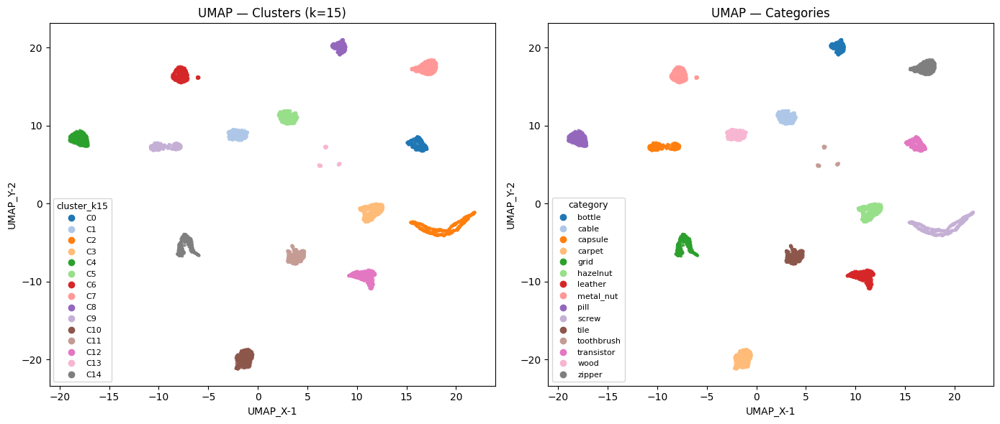

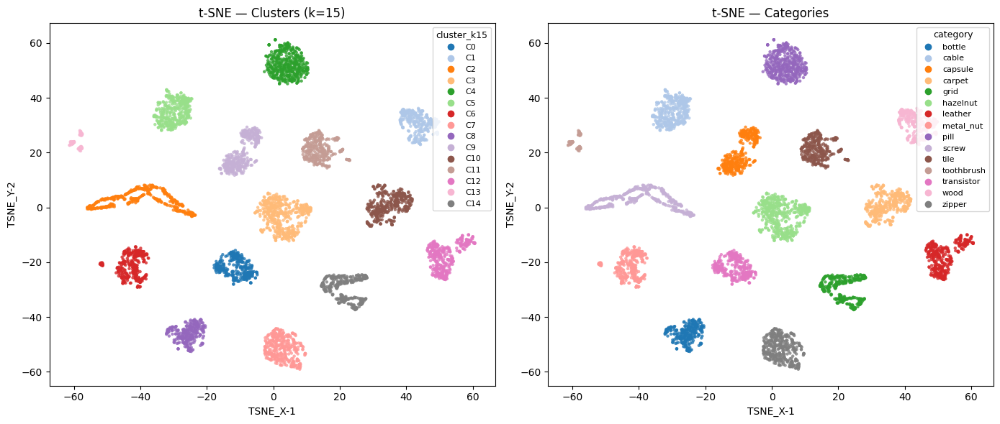

In [39]:
# === 7.4 — UMAP / t-SNE side-by-side: Clusters vs Categories ===
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib.lines import Line2D

# --- dtype-aware helpers ---
def make_colors_and_palette(series):
    """
    Build colors for any label type (numeric clusters or string categories).
    Returns: colors list, palette dict, display_map dict
    """
    cmap = plt.get_cmap("tab20")
    default = (0.7, 0.7, 0.7, 0.5)

    if pd.api.types.is_numeric_dtype(series):
        vals = pd.Series(series).astype("Int64")  # keep NaNs
        keys = np.sort(vals.dropna().unique().astype(int)).tolist()
        palette = {k: cmap(i % 20) for i, k in enumerate(keys)}
        display_map = {k: f"C{k}" for k in keys}
        colors = [palette.get(int(v), default) if pd.notna(v) else default for v in vals]
        return colors, palette, display_map

    # categorical / string labels
    cats = series.astype("category")
    keys = list(cats.cat.categories)
    palette = {k: cmap(i % 20) for i, k in enumerate(keys)}
    display_map = {k: str(k) for k in keys}
    vals = series.astype("object")
    colors = [palette.get(v, default) if pd.notna(v) else default for v in vals]
    return colors, palette, display_map

def add_legend(ax, palette, display_map, title=None, max_items=20):
    keys = list(palette.keys())
    if not keys:
        return
    shown = keys[:max_items]
    handles = [
        Line2D([0], [0], marker="o", linestyle="", markersize=6,
               color=palette[k], label=display_map.get(k, str(k)))
        for k in shown
    ]
    if len(keys) > max_items:
        handles.append(Line2D([0], [0], marker="o", linestyle="", markersize=6,
                              color="k", label="…"))
    ax.legend(handles=handles, title=title, frameon=True,
              fontsize=8, title_fontsize=9, loc="best")


# --- ensure needed columns ---
if "cluster_k15" not in df_proj.columns and "cluster_k15" in meta.columns:
    df_proj = df_proj.merge(meta[["path", "cluster_k15"]], on="path", how="left")
if "category" not in df_proj.columns and "category" in meta.columns:
    df_proj = df_proj.merge(meta[["path", "category"]], on="path", how="left")

# --- plotting function ---
def plot_side_by_side(df, proj_x, proj_y, col_a, col_b, title_a, title_b):
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))

    # Left: col_a
    clrs_a, palette_a, display_map_a = make_colors_and_palette(df[col_a])
    axes[0].scatter(df[proj_x], df[proj_y], s=10, c=clrs_a, alpha=0.8, linewidths=0)
    axes[0].set_title(title_a)
    axes[0].set_xlabel(f"{proj_x.upper()}-1")
    axes[0].set_ylabel(f"{proj_y.upper()}-2")
    add_legend(axes[0], palette_a, display_map_a, title=col_a)

    # Right: col_b
    clrs_b, palette_b, display_map_b = make_colors_and_palette(df[col_b])
    axes[1].scatter(df[proj_x], df[proj_y], s=10, c=clrs_b, alpha=0.8, linewidths=0)
    axes[1].set_title(title_b)
    axes[1].set_xlabel(f"{proj_x.upper()}-1")
    axes[1].set_ylabel(f"{proj_y.upper()}-2")
    add_legend(axes[1], palette_b, display_map_b, title=col_b)

    plt.tight_layout()
    plt.show()


# --- UMAP: clusters vs categories ---
if {"umap_x", "umap_y", "cluster_k15", "category"}.issubset(df_proj.columns):
    plot_side_by_side(
        df_proj, "umap_x", "umap_y",
        col_a="cluster_k15", col_b="category",
        title_a="UMAP — Clusters (k=15)",
        title_b="UMAP — Categories"
    )

# --- t-SNE: clusters vs categories ---
if {"tsne_x", "tsne_y", "cluster_k15", "category"}.issubset(df_proj.columns):
    plot_side_by_side(
        df_proj, "tsne_x", "tsne_y",
        col_a="cluster_k15", col_b="category",
        title_a="t-SNE — Clusters (k=15)",
        title_b="t-SNE — Categories"
    )



### Cluster Separation in UMAP & t-SNE

- **Distinct class boundaries:** All **15 image classes** form **clearly separated clusters** with **no mixing between categories**.
- **Minor peripheral points:** A few samples are located **slightly outside** their main cluster, yet can still be **visually assigned** to that cluster based on proximity.
- **Consistent patterns:** For the **same class**, the **cluster shape and position** are **highly similar** in both **UMAP** and **t-SNE**, indicating that the structure is **robust across projection methods**.

*Conclusion:* The embeddings exhibit strong, well-defined class separation with only minor, visually explainable outliers.


## K-Means with k = 30 — Separation of super_label within Categories

After evaluating the clustering with **k = 15** (one cluster per image category), we now increase the number of clusters to **k = 30**.  
The goal is to investigate whether the two values of **`super_label`** (*good* and *defect*) can be **separated within each category** when the clustering granularity is doubled.

- **Rationale:**  
  With `k = 30`, each of the 15 categories can, in theory, split into two sub-clusters — one representing `super_label = good` and one representing `super_label = defect`.
- **Expectation:**  
  Based on the UMAP and t-SNE visualizations above — where points were labeled by `super_label` — there is **no clear visual indication** that these two classes are already separable within the category clusters.  
  Therefore, it is unlikely that increasing `k` will produce clean, well-separated `super_label`-based sub-clusters for each category.
- **Evaluation:**  
  Cluster assignments will be compared against the `super_label` column to assess how consistently `super_label = good` and `super_label = defect` samples are assigned to separate clusters.


In [41]:
# --- KMeans k=30 ---
k30 = 30
km30 = KMeans(n_clusters=k30, n_init=20, max_iter=500, random_state=0)
lab30 = km30.fit_predict(X_pca)
sil30 = silhouette_score(X_pca, lab30) if len(np.unique(lab30)) > 1 else -1.0
print(f"[KMeans] k={k30}, silhouette={sil30:.4f}")

# Attach to meta
meta["cluster_k30"] = lab30

# Basic summaries
print("\nCluster sizes (k=30):")
print(meta["cluster_k30"].value_counts().sort_index())

if "super_label" in meta.columns:
    print("\nCluster × super_label (k=30):")
    print(meta.pivot_table(index="cluster_k30", columns="super_label", aggfunc="size", fill_value=0))

if "category" in meta.columns:
    print("\nCluster × category (k=30):")
    print(meta.pivot_table(index="cluster_k30", columns="category", aggfunc="size", fill_value=0))


[KMeans] k=30, silhouette=0.4257

Cluster sizes (k=30):
cluster_k30
0     155
1      44
2     232
3     391
4     434
5     101
6     148
7     178
8     397
9     292
10    331
11     40
12    130
13     75
14    158
15     57
16    102
17    102
18    263
19    196
20    117
21     69
22     90
23     16
24    103
25    294
26    221
27    262
28    282
29     74
Name: count, dtype: int64

Cluster × category (k=30):
category     bottle  cable  capsule  carpet  grid  hazelnut  leather  \
cluster_k30                                                            
0                 0      0        0       0     0         0        0   
1                 0      0        0       0     0         0        0   
2                 0      0        0       0     0         0        0   
3                 0      0        0       0     0         0        0   
4                 0      0        0       0     0         0        0   
5                 0      0        0       0     0         0        0   
6 

## Observations from K-Means with k = 30

The K-Means clustering with **k = 30** was performed on the PCA-reduced features.  
With 30 clusters and 15 categories, the expectation would be that **each category is split into two clusters** — one containing mostly `super_label = good` samples and the other containing mostly `super_label = defect` samples.

However, the output shows that this pattern does not consistently occur:

- **Example:** The category *bottle* is represented almost entirely in **cluster 9**, rather than being split across two clusters.
- **Example:** The category *grid* is spread across **four different clusters**.

These results suggest that **some categories cannot be cleanly separated** into distinct `good` and `defect` clusters based on the current feature space, while **other categories may be better suited** to such separation.

**Next step:** We will investigate this further through **visualization**, using UMAP and t-SNE plots colored by both `category` and `super_label` to see how the data points are distributed within each category.


In [46]:
# === Patch (robust): ensure category & super_label in df_proj with key checks ===
import numpy as np
import pandas as pd

def ensure_super_label(meta: pd.DataFrame) -> pd.DataFrame:
    """
    Ensure meta has a 'super_label' column with values 'good' or 'defect'.
    Attempts several common MVTec conventions; otherwise uses 'unknown'.
    """
    m = meta.copy()
    if "super_label" in m.columns:
        return m

    if "label_dir" in m.columns:
        m["super_label"] = np.where(m["label_dir"].astype(str) == "good", "good", "defect")
        return m

    if "defect_type" in m.columns:
        m["super_label"] = np.where(m["defect_type"].isna(), "good", "defect")
        return m

    for c in ("is_good", "good_flag"):
        if c in m.columns:
            m["super_label"] = np.where(m[c].astype(bool), "good", "defect")
            return m

    m["super_label"] = "unknown"
    return m


def _check_unique_key(df: pd.DataFrame, key: str, df_name: str, show=5) -> bool:
    """Return True if key is unique, otherwise print warning and a preview of duplicates."""
    if key not in df.columns:
        print(f"[WARN] '{key}' not found in {df_name}.")
        return False
    dup_mask = df.duplicated(subset=[key], keep=False)
    if dup_mask.any():
        dups = df.loc[dup_mask, key].value_counts()
        print(f"[WARN] '{key}' is NOT unique in {df_name} ({dup_mask.sum()} duplicate rows).")
        print(f"       Example duplicate keys in {df_name}: {list(dups.index[:show])}")
        return False
    return True


def _deduplicate_on_key(df: pd.DataFrame, key: str, how="first") -> pd.DataFrame:
    """
    Deduplicate on 'key' with a chosen strategy (default: keep first).
    Prints a warning if rows are dropped.
    """
    before = len(df)
    out = df.drop_duplicates(subset=[key], keep=how)
    dropped = before - len(out)
    if dropped > 0:
        print(f"[INFO] Dropped {dropped} duplicate rows in dataframe on key='{key}' (keep='{how}').")
    return out


def safe_merge_on_path(
    df_proj: pd.DataFrame,
    meta: pd.DataFrame,
    cols: list,
    fill_na_from_meta: bool = True,
) -> pd.DataFrame:
    """
    Safely ensure columns from 'meta' are present in 'df_proj' by merging on 'path'.
    - Verifies 'path' key exists and is unique (deduplicates if needed).
    - Only adds missing columns; if column exists in df_proj and 'fill_na_from_meta' is True,
      fills NaNs in df_proj from meta without overwriting non-NaNs.
    """
    if "path" not in df_proj.columns:
        raise KeyError("df_proj is missing required key column 'path'.")
    if "path" not in meta.columns:
        raise KeyError("meta is missing required key column 'path'.")

    # Check & de-duplicate
    ok_proj = _check_unique_key(df_proj, "path", "df_proj")
    ok_meta = _check_unique_key(meta, "path", "meta")
    if not ok_proj:
        df_proj = _deduplicate_on_key(df_proj, "path", how="first")
    if not ok_meta:
        meta = _deduplicate_on_key(meta, "path", how="first")

    # Determine which columns to bring over
    to_add = [c for c in cols if c not in df_proj.columns and c in meta.columns]
    to_fill = [c for c in cols if (c in df_proj.columns and fill_na_from_meta and c in meta.columns)]

    # Merge only if needed
    if to_add:
        df_proj = df_proj.merge(meta[["path"] + to_add], on="path", how="left")
        print(f"[INFO] Added columns from meta -> df_proj: {to_add}")

    if to_fill:
        # Map values from meta for filling NaNs
        meta_subset = meta.set_index("path")[to_fill]
        # Align by path index
        df_proj = df_proj.set_index("path")
        # Fill NaNs per column
        for c in to_fill:
            n_before = df_proj[c].isna().sum()
            df_proj[c] = df_proj[c].where(df_proj[c].notna(), meta_subset[c])
            n_after = df_proj[c].isna().sum()
            if n_after < n_before:
                print(f"[INFO] Filled {n_before - n_after} NaN values in '{c}' from meta.")
        df_proj = df_proj.reset_index()

    missing_after = [c for c in cols if c not in df_proj.columns]
    if missing_after:
        print(f"[WARN] Some requested columns are still missing in df_proj: {missing_after}")

    return df_proj


# ====== Apply the robust pipeline ======
# 1) Ensure meta has 'super_label'
meta = ensure_super_label(meta)

# 2) Bring needed columns into df_proj (add or fill NaNs, but don't overwrite existing values)
needed = ["cluster_k30", "category", "super_label"]
df_proj = safe_merge_on_path(df_proj, meta, needed, fill_na_from_meta=True)

# 3) Build combined label safely: "<category> | <super_label>"
df_proj["category_super"] = (
    df_proj.get("category", pd.Series(index=df_proj.index, dtype="string")).astype("string").fillna("unknown")
    + " | " +
    df_proj.get("super_label", pd.Series(index=df_proj.index, dtype="string")).astype("string").fillna("unknown")
)

# 4) Quick diagnostics
print("Columns available:",
      {c: (c in df_proj.columns) for c in ["cluster_k30", "category", "super_label", "category_super"]})


Columns available: {'cluster_k30': True, 'category': True, 'super_label': True, 'category_super': True}


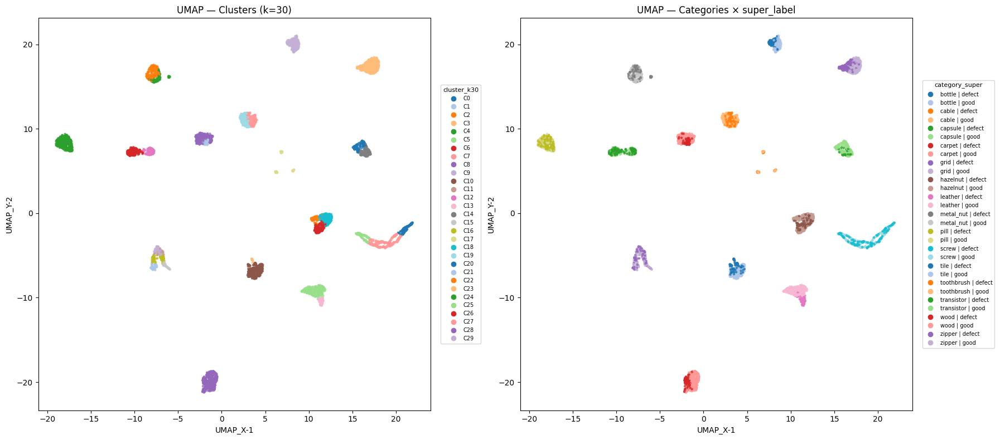

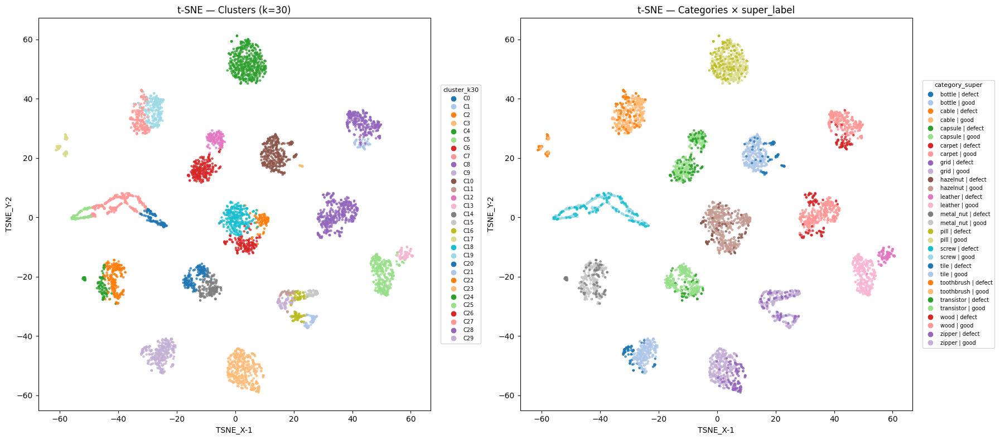

In [49]:
# === 7.4 — UMAP / t-SNE side-by-side: Clusters (k=30) vs Categories × super_label (full legend) ===
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib.lines import Line2D

# --- dtype-aware helpers (unchanged) ---
def make_colors_and_palette(series):
    """
    Build colors for any label type (numeric clusters or string categories).
    Returns: colors list, palette dict, display_map dict
    """
    cmap = plt.get_cmap("tab20")
    default = (0.7, 0.7, 0.7, 0.5)

    if pd.api.types.is_numeric_dtype(series):
        vals = pd.Series(series).astype("Int64")  # keep NaNs
        keys = np.sort(vals.dropna().unique().astype(int)).tolist()
        palette = {k: cmap(i % 20) for i, k in enumerate(keys)}
        display_map = {k: f"C{k}" for k in keys}
        colors = [palette.get(int(v), default) if pd.notna(v) else default for v in vals]
        return colors, palette, display_map

    # categorical / string labels
    cats = series.astype("category")
    keys = list(cats.cat.categories)
    palette = {k: cmap(i % 20) for i, k in enumerate(keys)}
    display_map = {k: str(k) for k in keys}
    vals = series.astype("object")
    colors = [palette.get(v, default) if pd.notna(v) else default for v in vals]
    return colors, palette, display_map

def add_legend(ax, palette, display_map, title=None, max_items=None):
    """
    Generic legend for both numeric and string labels.
    max_items=None -> show all entries. Legend placed outside.
    """
    keys = list(palette.keys())
    if not keys:
        return

    shown = keys if max_items is None else keys[:max_items]
    handles = [
        Line2D([0], [0], marker="o", linestyle="", markersize=6,
               color=palette[k], label=display_map.get(k, str(k)))
        for k in shown
    ]
    if max_items is not None and len(keys) > max_items:
        handles.append(Line2D([0], [0], marker="o", linestyle="", markersize=6,
                              color="k", label="…"))

    ax.legend(handles=handles, title=title, frameon=True,
              fontsize=7, title_fontsize=8,
              loc="center left", bbox_to_anchor=(1.02, 0.5))  # outside right

# --- ensure needed columns ---
# Merge k=30 clusters
if "cluster_k30" not in df_proj.columns and "cluster_k30" in meta.columns:
    df_proj = df_proj.merge(meta[["path", "cluster_k30"]], on="path", how="left")

# Merge category and super_label
need_cols = ["category", "super_label"]
missing = [c for c in need_cols if c not in df_proj.columns and c in meta.columns]
if missing:
    df_proj = df_proj.merge(meta[["path"] + missing], on="path", how="left")

# Build combined label: "<category> | <super_label>" (e.g., "bottle | good")
if "category" in df_proj.columns and "super_label" in df_proj.columns:
    df_proj["category_super"] = (
        df_proj["category"].astype("string").fillna("unknown")
        + " | "
        + df_proj["super_label"].astype("string").fillna("unknown")
    )
else:
    print("Warning: 'category' and/or 'super_label' not available; combined labeling may be incomplete.")
    df_proj["category_super"] = (
        df_proj.get("category", pd.Series(index=df_proj.index, dtype="string")).astype("string").fillna("unknown")
        + " | " +
        df_proj.get("super_label", pd.Series(index=df_proj.index, dtype="string")).astype("string").fillna("unknown")
    )

# --- generic side-by-side plotting (legend outside, bigger fig) ---
def plot_side_by_side(df, proj_x, proj_y, col_a, col_b, title_a, title_b):
    # larger figure; leave room on the right for legends
    fig, axes = plt.subplots(1, 2, figsize=(18, 8), constrained_layout=False)
    fig.subplots_adjust(right=0.78)  # space for outside legends

    # Left: col_a
    clrs_a, palette_a, display_map_a = make_colors_and_palette(df[col_a])
    axes[0].scatter(df[proj_x], df[proj_y], s=10, c=clrs_a, alpha=0.8, linewidths=0)
    axes[0].set_title(title_a)
    axes[0].set_xlabel(f"{proj_x.upper()}-1")
    axes[0].set_ylabel(f"{proj_y.upper()}-2")
    add_legend(axes[0], palette_a, display_map_a, title=col_a, max_items=None)  # show all

    # Right: col_b
    clrs_b, palette_b, display_map_b = make_colors_and_palette(df[col_b])
    axes[1].scatter(df[proj_x], df[proj_y], s=10, c=clrs_b, alpha=0.8, linewidths=0)
    axes[1].set_title(title_b)
    axes[1].set_xlabel(f"{proj_x.upper()}-1")
    axes[1].set_ylabel(f"{proj_y.upper()}-2")
    add_legend(axes[1], palette_b, display_map_b, title=col_b, max_items=None)  # show all

    plt.tight_layout()
    plt.show()

# --- UMAP: k=30 clusters vs categories × super_label ---
if {"umap_x", "umap_y", "cluster_k30", "category_super"}.issubset(df_proj.columns):
    plot_side_by_side(
        df_proj, "umap_x", "umap_y",
        col_a="cluster_k30", col_b="category_super",
        title_a="UMAP — Clusters (k=30)",
        title_b="UMAP — Categories × super_label"
    )
else:
    missing = {"umap_x", "umap_y", "cluster_k30", "category_super"} - set(df_proj.columns)
    print(f"UMAP skipped; missing: {missing}")

# --- t-SNE: k=30 clusters vs categories × super_label ---
if {"tsne_x", "tsne_y", "cluster_k30", "category_super"}.issubset(df_proj.columns):
    plot_side_by_side(
        df_proj, "tsne_x", "tsne_y",
        col_a="cluster_k30", col_b="category_super",
        title_a="t-SNE — Clusters (k=30)",
        title_b="t-SNE — Categories × super_label"
    )
else:
    missing = {"tsne_x", "tsne_y", "cluster_k30", "category_super"} - set(df_proj.columns)
    print(f"t-SNE skipped; missing: {missing}")



### Conclusion

The results confirm the initial expectation:  
**K-Means with k = 30** does not split the individual categories into clearly separated `good` and `defect` clusters.  

In some cases, `good` and `defect` samples are grouped together into the same cluster, while in other cases a category is split into several clusters — but still without a consistent separation between the two labels. As a result, the clusters do not provide a clear distinction between `good` and `defect`.


### 7.5 – Outlier Identification

Since K-Means already separates the categories cleanly, an outlier analysis across all clusters provides little additional insight.  
Within most clusters, the assigned samples belong entirely to a single category, meaning that large distances to the cluster center are rare and often not meaningful in a cross-category context.  

A more valuable approach would be to perform outlier detection **within each category**, where unusual lighting conditions, atypical defects, or mislabeled samples could be revealed.  
However, this was not pursued here to avoid fragmenting the EDA into overly small steps.


## 8 – EDA Conclusion

The exploratory data analysis provided a clear understanding of the dataset structure, quality, and feature-space characteristics.  
Fifteen relevant categories were identified (excluding `.ipynb_checkpoints`). The train splits contain only *good* images, while the test splits contain both *good* and *defect* samples. The test split has a higher proportion of defect images, reflecting the focus of this work. Ground-truth masks generally align with the defect areas, although defect sizes vary significantly across categories, with some extreme outliers (e.g., *transistor*, *metal_nut*).  

Visual inspection confirmed clear differences between *good* and *defect* images within the same category, but also revealed that some defects are subtle and difficult to detect.  

In the feature space, PCA combined with UMAP/t-SNE showed a clear separation between categories, but **no consistent separation between *good* and *defect***. This was also reflected in the K-Means clustering, which grouped samples primarily by category and placed *good* and *defect* either in the same or in different clusters.  

Overall, the EDA confirms that while category-level separation is strong, distinguishing between *good* and *defect* in the current feature space remains challenging.  
A dedicated machine learning approach, specifically optimized for this distinction, will therefore be required in the subsequent stages of the project.


In [ ]:
## Day 2 – Extracting ViT Embeddings (Feature Bank Creation)

In this step, we prepare the foundation for all subsequent anomaly detection tasks.  
Our goal is to process all *normal* training images through a pre-trained Vision Transformer (ViT) backbone and store the resulting **patch-level embeddings** as a **feature bank**.  

These embeddings will later be compared against test images to compute anomaly scores and generate heatmaps.  
By separating feature extraction from the actual scoring step, we can avoid repeatedly running the backbone model, which significantly speeds up experimentation.

**Main objectives for Day 2:**
- Load a pre-trained ViT backbone (e.g., DINOv2 or MAE).
- Apply the same preprocessing pipeline used during pre-training (resize, crop, normalization).
- Pass each *normal* training image through the model to extract patch embeddings.
- Normalize the embeddings for consistent distance computation.
- Store all embeddings per category on disk for later use.
- *(Optional)* Visual sanity check using UMAP/t-SNE on the extracted features.

Once completed, we will have a reusable feature bank that enables fast anomaly scoring and heatmap generation in the next stage.
